In [1]:
%load_ext autoreload
%autoreload 2
import os
import glob
import pickle
import matplotlib.pyplot as plt
import numpy as np

In [2]:
%matplotlib inline
fig_width = 15

from aSPEM import Analysis
import bayesianchangepoint as bcp

In [3]:
list_sujet = ['s01','s02','s03','s04','s05','s06','s07','s08','s09','s10','s11','s12']
nb_sujet = len(list_sujet)

In [4]:
liste = []
for fname in glob.glob('../data/*pkl'):
    a = fname.split('/')[2].split('.')[0].split('_')
    liste.append(a)
            
BET = {}
for x in range(len(liste)) :
    if liste[x][0]=='bet' and liste[x][1] in list_sujet:
        a = '../data/%s_%s_%s_%s.pkl'%(liste[x][0], liste[x][1],liste[x][2],liste[x][3])
        with open(a, 'rb') as fichier :
            b = pickle.load(fichier, encoding='latin1')
            b['observer'] = liste[x][1]
            BET[liste[x][1]] = b

In [5]:
e = Analysis(observer='s01', mode='eyeMvt')
Full = e.Full_list(modes_bcp=None)

# Scaling Data

In [6]:
file = os.path.join('parametre', 'Data_Scaling.pkl')
with open(file, 'rb') as fichier:
    new_data = pickle.load(fichier, encoding='latin1')

In [7]:
new_bet_full = new_data['new_bet_full']
new_bet_sujet = new_data['new_bet_sujet']
new_va_full = new_data['new_va_full']
new_va_sujet = new_data['new_va_sujet']

# Variation de h

In [8]:
file = os.path.join('parametre/list_h', 'list_h_LOG.pkl')
with open(file, 'rb') as fichier:
    liste_h = pickle.load(fichier, encoding='latin1')

In [9]:
h_bet_full = liste_h['h_bet_full']
h_va_full = liste_h['h_va_full']
h_bet_sujet = liste_h['h_bet_sujet']
h_va_sujet = liste_h['h_va_sujet']

## evaluating the best hazard rate using a likelihood score between the predicted biases using different values of the hazard rate

In [10]:
def KL_distance(p_data, p_hat):
    distance = p_hat * np.log2(p_hat) - p_hat * np.log2(p_data + 1.*(p_data==0.))
    distance += (1-p_hat) * np.log2(1-p_hat) - (1-p_hat) * np.log2(1-p_data + 1.*(p_data==1.))
    return distance

In [11]:
def plot_evaluating(ax, h_eval, data, trials, bino, p, mode):

    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    distance = np.zeros(len(trials))
    p_hat = np.zeros(len(trials))
    p_low, p_sup = np.zeros_like(distance), np.zeros_like(distance)
    
    
    p_bar, r, beliefs = bcp.inference(bino, h=h_eval, p0=p0, r0=r0, verbose=False)
    p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
    from scipy.stats import beta
    for trial in range(len(trials)):
        a = p_hat[trial]*(r_hat[trial])
        b = (1-p_hat[trial])*(r_hat[trial])
        rv = beta(a, b)
        p_low[trial], p_sup[trial] = rv.ppf([.05, .95])
        distance[trial] = KL_distance(data[trial], p_hat[trial])

    distance = np.exp(-distance/np.median(distance))

    ax.step(trials, data, c='k', lw=1, alpha=.9)
    ax.plot(trials, p_hat, 'r', lw=1, alpha=.5)
    ax.scatter(trials, p_hat, c=distance, vmin=distance.min(), vmax=distance.max(), alpha=1., cmap=plt.get_cmap('RdGy'))  # coolwarm

    ax.fill_between(trials, np.zeros_like(p), p, lw=.5, alpha=0.2, facecolor='k', step='pre')
    ax.fill_between(trials, p_sup, p_low, lw=.2, alpha=0.2, facecolor='r', step='mid')
    ax.plot(trials, p_sup, 'r--', lw=1, alpha=.9)
    ax.plot(trials, p_low, 'r--', lw=1, alpha=.9)
    ax.set_ylim(-0.1, 1.2)
    
    return ax

In [12]:
def find_best_h(ax, data, bino, h_sujet, mode, N_scan):
    
    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    hs = np.logspace(-1, 1, N_scan, base=N_scan)/N_scan

    full_distance = np.zeros(N_scan)
    for i_scan, h_ in enumerate(hs):
        p_bar, r, beliefs = bcp.inference(bino, h=h_, p0=p0, r0=r0, verbose=False)
        p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
        d_ = KL_distance(np.array(data), p_hat)

        full_distance[i_scan] = np.mean(d_)

    ax.plot(hs, full_distance, 'k')
    ax.vlines(h_sujet, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='k', linestyle='--', lw=2)

    h_opt = hs[np.argmin(full_distance)]
    ax.vlines(h_opt, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='r', linestyle='--', lw=2)
    ax.set_xscale("log")
    ax.set_ylim(0)
    ax.set_xlabel('Hazard rate')
    ax.set_ylabel('distance')
    return ax, h_opt

In [13]:
import matplotlib.gridspec as gridspec

def evaluating (data_sujet, data_full, h_sujet, h_full, show='h_block'):
    
    
    for x, sujet in enumerate(list_sujet) :
        print(sujet)

        fig = plt.figure(figsize=(30,30/2))
        axs = gridspec.GridSpec(3, 2, hspace=0.2)

        mode = 'mean'

        N_trials, N_blocks = BET[sujet]['N_trials'], BET[sujet]['N_blocks']

        tau_true = 40. # N_trials/10.
        h_true = 1./tau_true
  
        for y in range(2) :
            if y==0 :
                data_eval, h_eval = data_sujet, h_sujet
                titre = 'scalling sujet'
            else :
                data_eval, h_eval = data_full, h_full
                titre = 'scalling full'
            print('\n%s'%(titre))
            
            nb_trial = 0
            l=0
            for block in range(N_blocks) :
                
                bino = np.array(list(Full['bino'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                p = np.array(list(Full['proba'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                
                print('block', block, end='')
                gs1 = gridspec.GridSpecFromSubplotSpec(2, 3, subplot_spec=axs[2*block+y], wspace=0.5)
                ax1 = plt.Subplot(fig, gs1[0,:-1])
                ax2 = plt.Subplot(fig, gs1[:,-1])
                ax3 = plt.Subplot(fig, gs1[1,:-1])
                fig.add_subplot(ax1)
                fig.add_subplot(ax3)
                
                if show=='h_block' :
                    fig.add_subplot(ax2)
                    data = data_eval[sujet][block]
                    h_fit = h_eval['block'][sujet][block]

                    trials = range(len(data))
                    ax1 = plot_evaluating(ax1, h_fit, data, trials, bino, p, mode)
                    ax1.set_ylabel('tau_fit=%.1f'%(1/h_fit))

                    ax2, h_opt = find_best_h(ax2, data, bino, h_fit, mode, N_scan=100)

                    ax3 = plot_evaluating(ax3, h_opt, data, trials, bino, p, mode)
                    ax3.set_ylabel('tau_opt=%.1f'%(1/h_opt))
                    print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt))

                if show=='h_pause' :
                    gs2 = gridspec.GridSpecFromSubplotSpec(2, 2, subplot_spec=ax2, wspace=0.4, hspace=0.4)
                    
                    liste = [0,50,100,150,200]
                    
                    for a in range(len(liste)-1) :
                        print('\npause', a, end='')
                        ax4 = plt.Subplot(fig, gs2[a])
                        fig.add_subplot(ax4)
                        
                        data = data_eval[sujet][block][liste[a]:liste[a+1]]
                        h_fit = h_eval['pause'][sujet][l]
                        bibi = bino[liste[a]:liste[a+1]]
                        pp = p[liste[a]:liste[a+1]]
                        
                        trials = range(liste[a], liste[a+1])
                        ax1 = plot_evaluating(ax1, h_fit, data, trials, bibi, pp, mode)
                        ax1.set_ylabel('tau_fit')
                        ax1.text(liste[a]+(liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_fit))
                        
                        ax4, h_opt = find_best_h(ax4, data, bibi, h_fit, mode, N_scan=100)
                        ax4.set_title(a)
                        ax4.set_ylabel('')
                        ax4.set_xlabel('')
                        
                        ax3 = plot_evaluating(ax3, h_opt, data, trials, bibi, pp, mode)
                        ax3.set_ylabel('tau_opt')
                        ax3.text((liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_opt))
                        
                        
                        if a==3:
                            end='\n'
                        else :
                            end=''
                        
                        print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt), end=end)
                        l=l+1

                if block==0 :
                    ax1.set_title(titre)

                nb_trial = nb_trial+N_trials

        plt.show() 

### BET

s01

scalling sujet
block 0 --> tau_fit=1363.4 , h_fit=0.00073 , tau_opt=890.2 , h_opt=0.00112
block 1 --> tau_fit=1484.1 , h_fit=0.00067 , tau_opt=1873.8 , h_opt=0.00053
block 2 --> tau_fit=271.5 , h_fit=0.00368 , tau_opt=200.9 , h_opt=0.00498

scalling full
block 0 --> tau_fit=1725.7 , h_fit=0.00058 , tau_opt=1873.8 , h_opt=0.00053
block 1 --> tau_fit=2.6 , h_fit=0.37987 , tau_opt=4.0 , h_opt=0.24771
block 2 --> tau_fit=189.0 , h_fit=0.00529 , tau_opt=152.0 , h_opt=0.00658


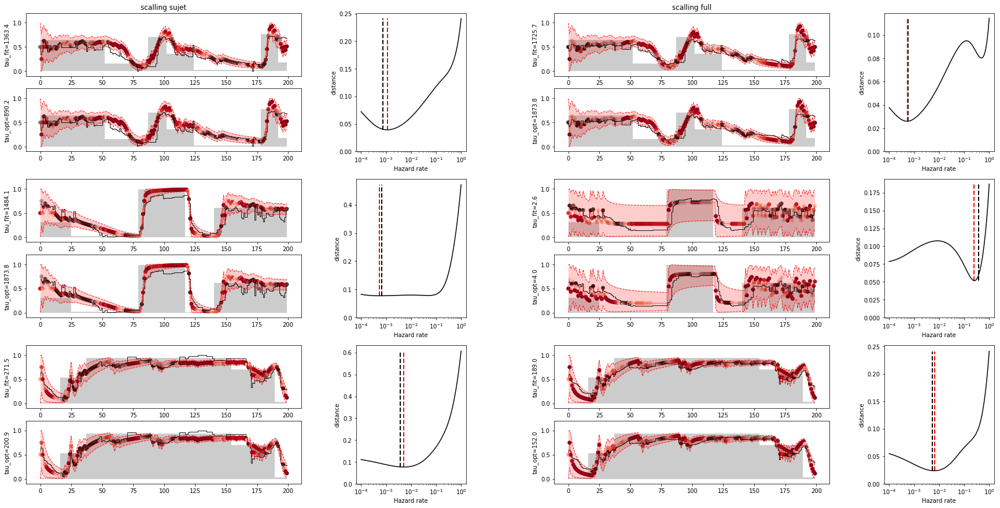

s02

scalling sujet
block 0 --> tau_fit=38.5 , h_fit=0.02597 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=5.5 , h_fit=0.18302 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=84.9 , h_fit=0.01178 , tau_opt=37.6 , h_opt=0.02656

scalling full
block 0 --> tau_fit=38.8 , h_fit=0.02578 , tau_opt=37.6 , h_opt=0.02656
block 1 --> tau_fit=6.5 , h_fit=0.15270 , tau_opt=14.8 , h_opt=0.06734
block 2 --> tau_fit=96.1 , h_fit=0.01041 , tau_opt=31.3 , h_opt=0.03199


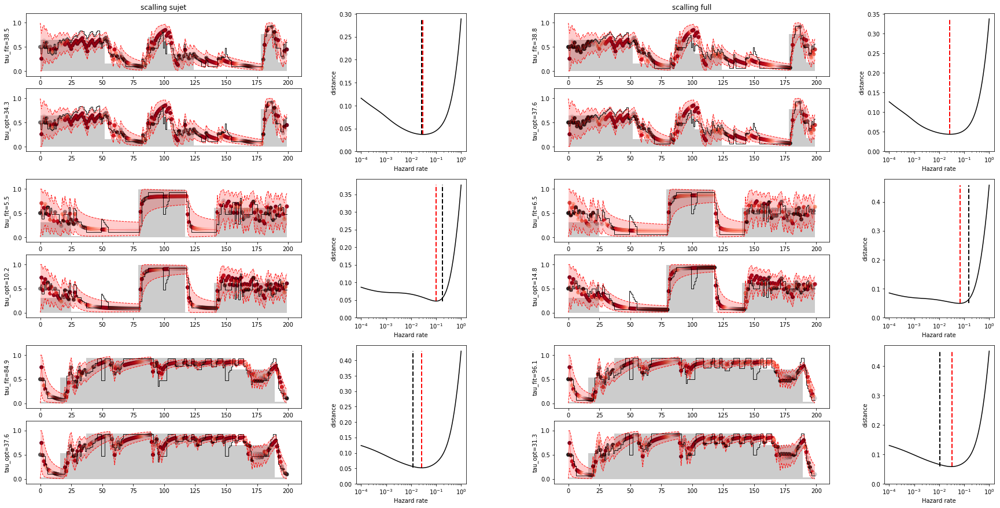

s03

scalling sujet
block 0 --> tau_fit=2.1 , h_fit=0.47048 , tau_opt=3.7 , h_opt=0.27186
block 1 --> tau_fit=5.5 , h_fit=0.18227 , tau_opt=11.2 , h_opt=0.08902
block 2 --> tau_fit=9.1 , h_fit=0.11028 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0 --> tau_fit=1.6 , h_fit=0.61874 , tau_opt=2.5 , h_opt=0.39442
block 1 --> tau_fit=4.2 , h_fit=0.23872 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=4.8 , h_fit=0.20948 , tau_opt=3.7 , h_opt=0.27186


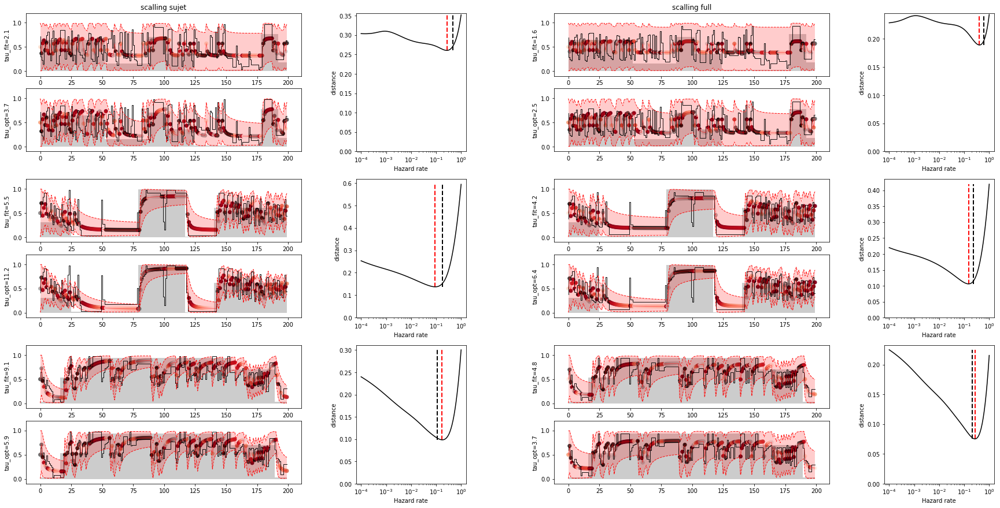

s04

scalling sujet
block 0 --> tau_fit=4.6 , h_fit=0.21928 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=7.7 , h_fit=0.12924 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=13.6 , h_fit=0.07337 , tau_opt=14.8 , h_opt=0.06734

scalling full
block 0 --> tau_fit=1.7 , h_fit=0.59518 , tau_opt=2.1 , h_opt=0.47508
block 1 --> tau_fit=2.3 , h_fit=0.43101 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=5.1 , h_fit=0.19772 , tau_opt=4.4 , h_opt=0.22570


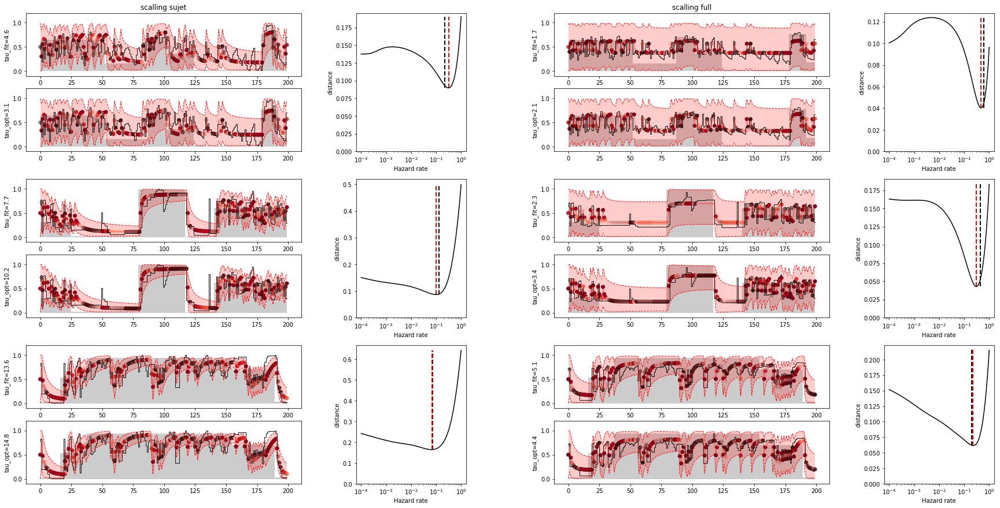

s05

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.43575 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.2 , h_fit=0.23576 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=13.9 , h_fit=0.07203 , tau_opt=13.5 , h_opt=0.07391

scalling full
block 0 --> tau_fit=3.1 , h_fit=0.32405 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.18006 , tau_opt=12.3 , h_opt=0.08111
block 2 --> tau_fit=17.8 , h_fit=0.05633 , tau_opt=16.3 , h_opt=0.06136


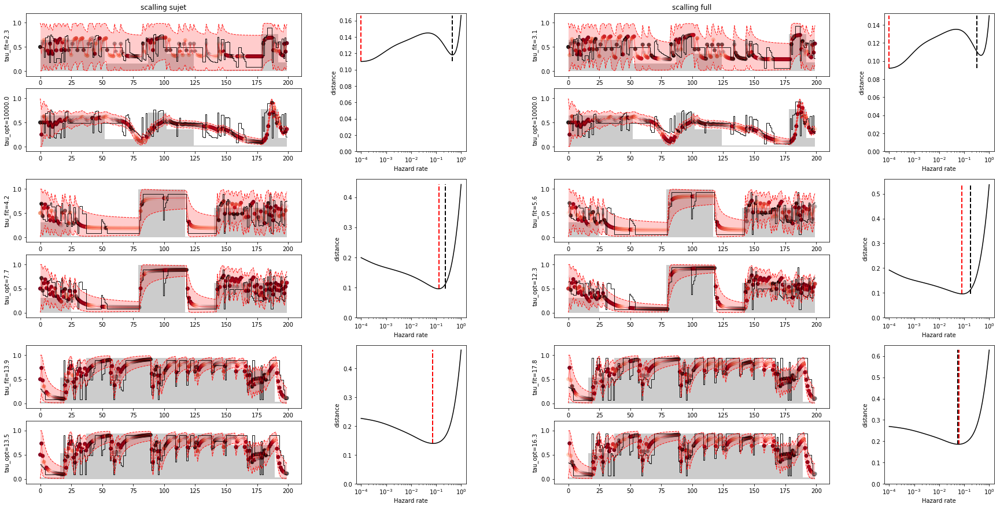

s06

scalling sujet
block 0 --> tau_fit=113.2 , h_fit=0.00883 , tau_opt=87.0 , h_opt=0.01150
block 1 --> tau_fit=12.6 , h_fit=0.07950 , tau_opt=34.3 , h_opt=0.02915
block 2 --> tau_fit=47.1 , h_fit=0.02123 , tau_opt=41.3 , h_opt=0.02420

scalling full
block 0 --> tau_fit=14754.2 , h_fit=0.00007 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.17857 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=39.8 , h_fit=0.02515 , tau_opt=3.1 , h_opt=0.32745


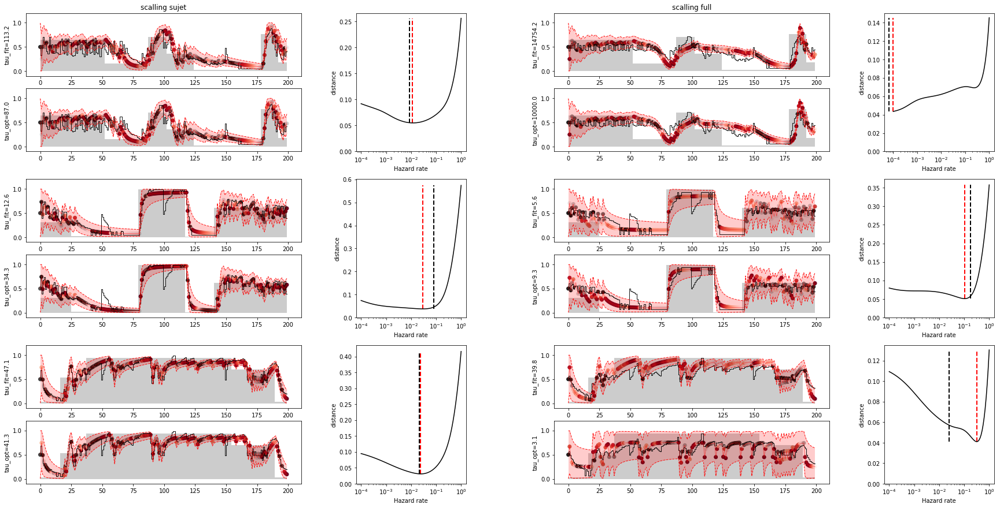

s07

scalling sujet
block 0 --> tau_fit=4.2 , h_fit=0.23708 , tau_opt=126.2 , h_opt=0.00792
block 1 --> tau_fit=9.1 , h_fit=0.11044 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=119.9 , h_fit=0.00834 , tau_opt=49.8 , h_opt=0.02009

scalling full
block 0 --> tau_fit=250.3 , h_fit=0.00399 , tau_opt=183.1 , h_opt=0.00546
block 1 --> tau_fit=3.6 , h_fit=0.27905 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=35.7 , h_fit=0.02803 , tau_opt=26.0 , h_opt=0.03854


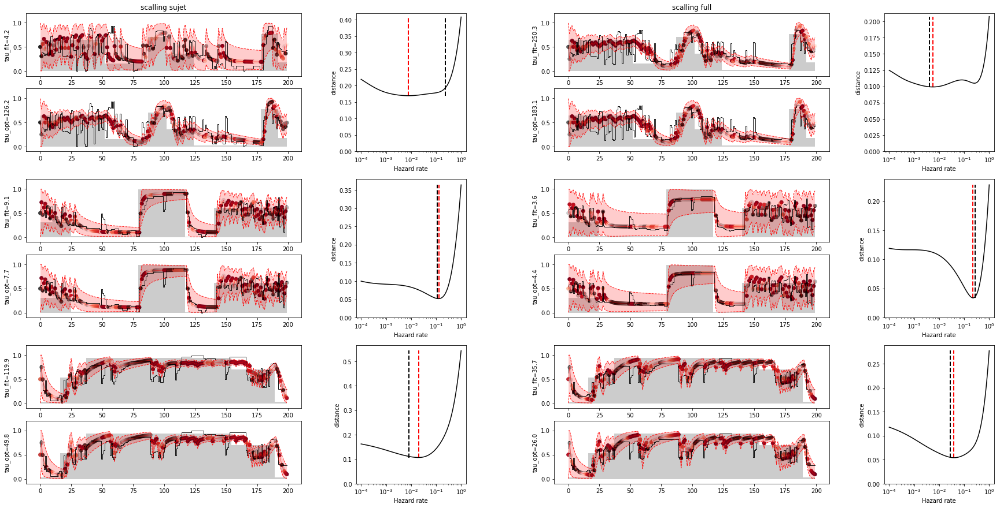

s08

scalling sujet
block 0 --> tau_fit=7023.7 , h_fit=0.00014 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=50.1 , h_fit=0.01995 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=8.8 , h_fit=0.11374 , tau_opt=8.5 , h_opt=0.11768

scalling full
block 0 --> tau_fit=5988.9 , h_fit=0.00017 , tau_opt=6892.6 , h_opt=0.00015
block 1 --> tau_fit=103.3 , h_fit=0.00968 , tau_opt=37.6 , h_opt=0.02656
block 2 --> tau_fit=12.1 , h_fit=0.08278 , tau_opt=12.3 , h_opt=0.08111


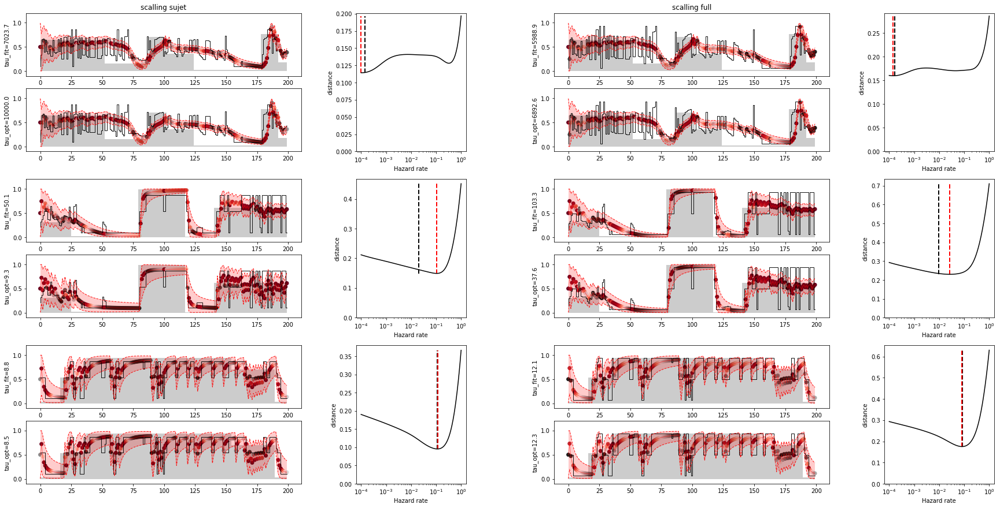

s09

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.42929 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=2.6 , h_fit=0.38139 , tau_opt=3.1 , h_opt=0.32745
block 2 --> tau_fit=78.0 , h_fit=0.01283 , tau_opt=291.5 , h_opt=0.00343

scalling full
block 0 --> tau_fit=33631.4 , h_fit=0.00003 , tau_opt=2.3 , h_opt=0.43288
block 1 --> tau_fit=2.2 , h_fit=0.46295 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=1.7 , h_fit=0.58932 , tau_opt=183.1 , h_opt=0.00546


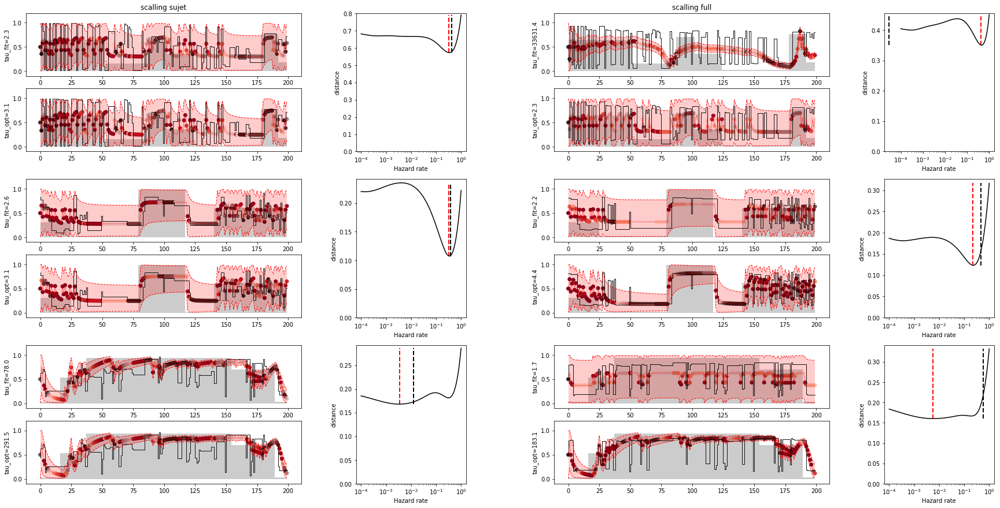

s10

scalling sujet
block 0 --> tau_fit=572.8 , h_fit=0.00175 , tau_opt=104.8 , h_opt=0.00955
block 1 --> tau_fit=3.8 , h_fit=0.26265 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=562.4 , h_fit=0.00178 , tau_opt=559.1 , h_opt=0.00179

scalling full
block 0 --> tau_fit=680.4 , h_fit=0.00147 , tau_opt=115.0 , h_opt=0.00870
block 1 --> tau_fit=3.7 , h_fit=0.27102 , tau_opt=5.3 , h_opt=0.18738
block 2 --> tau_fit=577.1 , h_fit=0.00173 , tau_opt=385.4 , h_opt=0.00260


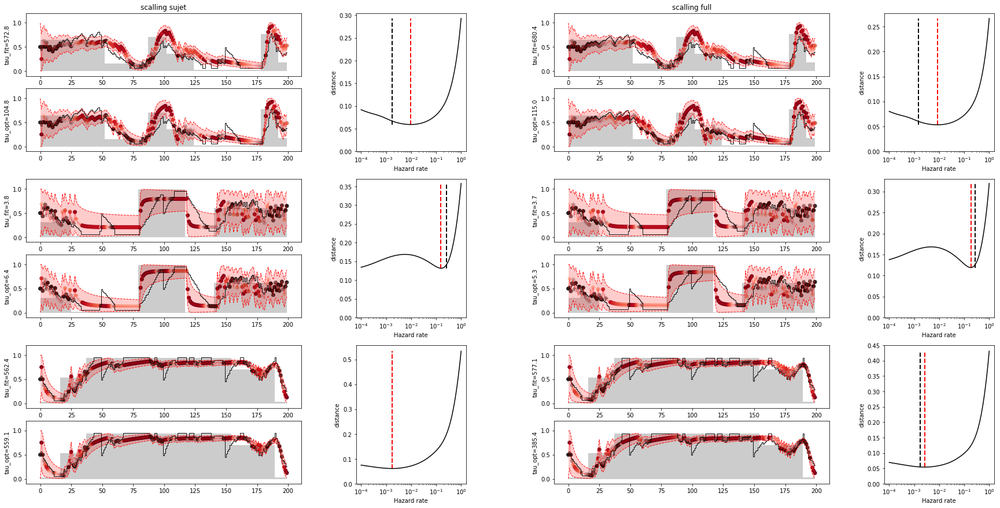

s11

scalling sujet
block 0 --> tau_fit=3.7 , h_fit=0.26674 , tau_opt=9111.6 , h_opt=0.00011
block 1 --> tau_fit=8.7 , h_fit=0.11522 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=31.6 , h_fit=0.03168 , tau_opt=34.3 , h_opt=0.02915

scalling full
block 0 --> tau_fit=18.0 , h_fit=0.05555 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=20.2 , h_fit=0.04950 , tau_opt=21.5 , h_opt=0.04642
block 2 --> tau_fit=44.2 , h_fit=0.02260 , tau_opt=41.3 , h_opt=0.02420


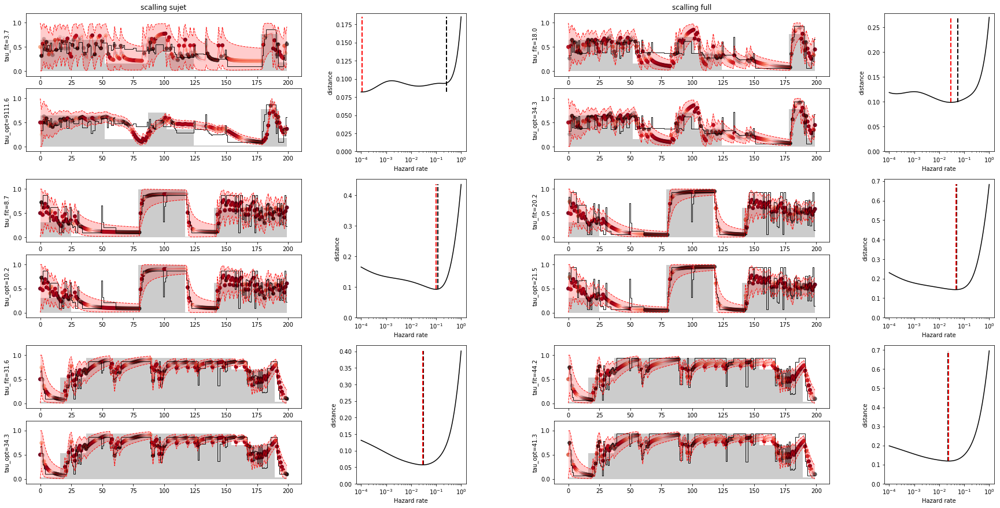

s12

scalling sujet
block 0 --> tau_fit=14768.9 , h_fit=0.00007 , tau_opt=1.9 , h_opt=0.52140
block 1 --> tau_fit=1.5 , h_fit=0.67910 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=4.9 , h_fit=0.20204 , tau_opt=4.4 , h_opt=0.22570

scalling full
block 0 --> tau_fit=178.6 , h_fit=0.00560 , tau_opt=95.5 , h_opt=0.01048
block 1 --> tau_fit=29.9 , h_fit=0.03347 , tau_opt=17.9 , h_opt=0.05591
block 2 --> tau_fit=14.0 , h_fit=0.07167 , tau_opt=23.6 , h_opt=0.04229


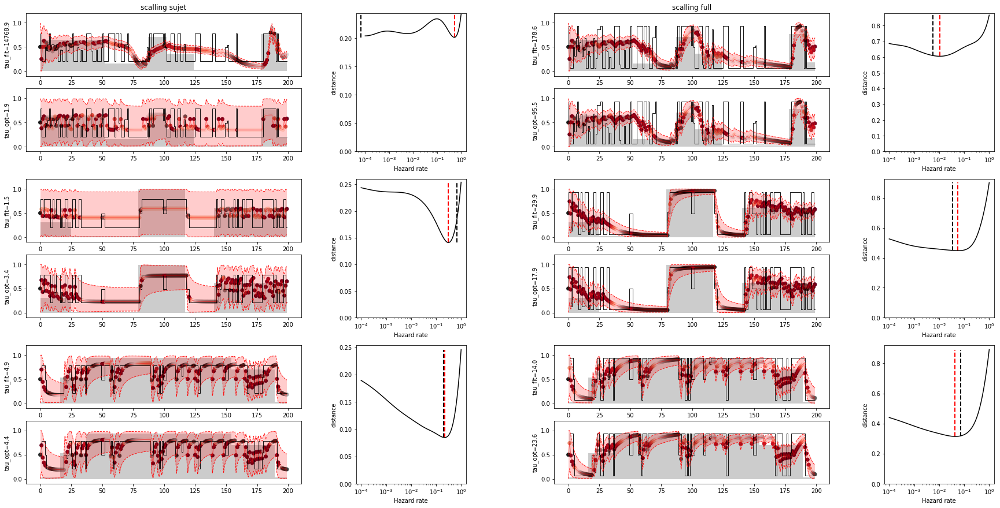

In [14]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full)

s01

scalling sujet
block 0
pause 0 --> tau_fit=1483.1 , h_fit=0.00067 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=2322.4 , h_fit=0.00043 , tau_opt=2983.6 , h_opt=0.00034
pause 2 --> tau_fit=367257572853.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=12455.5 , h_fit=0.00008 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=212.6 , h_fit=0.00470 , tau_opt=265.6 , h_opt=0.00376
pause 1 --> tau_fit=31313.3 , h_fit=0.00003 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=7764.5 , h_fit=0.00013 , tau_opt=6892.6 , h_opt=0.00015
pause 3 --> tau_fit=12.8 , h_fit=0.07798 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=713.7 , h_fit=0.00140 , tau_opt=559.1 , h_opt=0.00179
pause 1 --> tau_fit=118.1 , h_fit=0.00846 , tau_opt=200.9 , h_opt=0.00498
pause 2 --> tau_fit=19043069473.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=107.7 , h_fit=0.00928 , tau_opt=104.8 , h_opt=0.00955

scalling full
block 0
pause 0 --> tau_

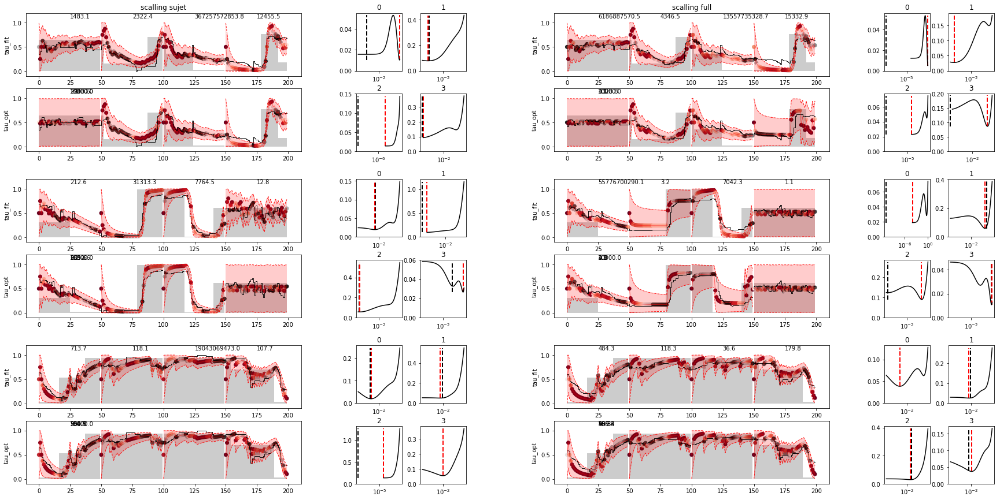

s02

scalling sujet
block 0
pause 0 --> tau_fit=44.8 , h_fit=0.02232 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=44.5 , h_fit=0.02245 , tau_opt=41.3 , h_opt=0.02420
pause 2 --> tau_fit=16.2 , h_fit=0.06168 , tau_opt=17.9 , h_opt=0.05591
pause 3 --> tau_fit=76.7 , h_fit=0.01304 , tau_opt=12.3 , h_opt=0.08111
block 1
pause 0 --> tau_fit=6.4 , h_fit=0.15510 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=302.2 , h_fit=0.00331 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=31.5 , h_fit=0.03176 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=1.1 , h_fit=0.93374 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=33.6 , h_fit=0.02976 , tau_opt=28.5 , h_opt=0.03511
pause 1 --> tau_fit=116.7 , h_fit=0.00857 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=20.6 , h_fit=0.04848 , tau_opt=28.5 , h_opt=0.03511
pause 3 --> tau_fit=22.0 , h_fit=0.04546 , tau_opt=26.0 , h_opt=0.03854

scalling full
block 0
pause 0 --> tau_fit=67.2 , h_fit=0.01488 , tau_opt=49.8 , h_opt=0.0200

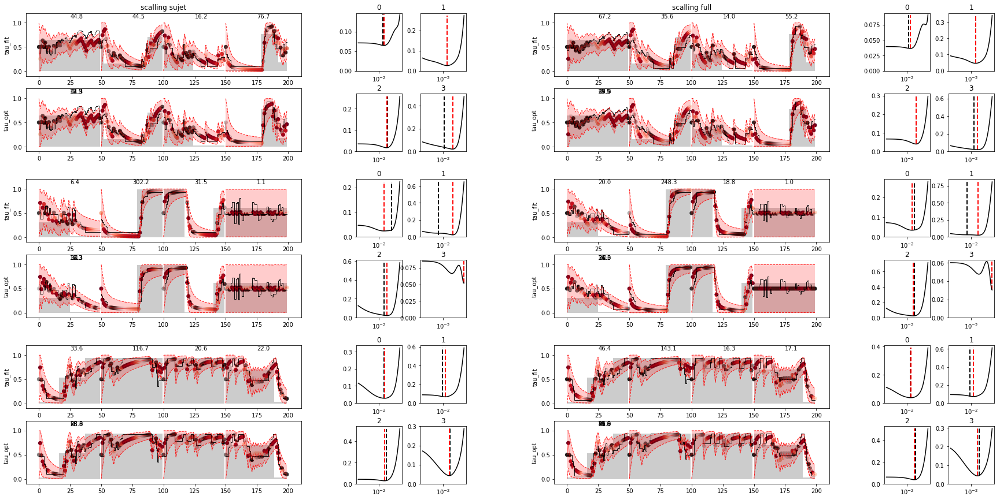

s03

scalling sujet
block 0
pause 0 --> tau_fit=72338283701.9 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=1.7 , h_fit=0.57144 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.3 , h_opt=0.75646
pause 3 --> tau_fit=8.8 , h_fit=0.11421 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=5.4 , h_fit=0.18632 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=5.7 , h_fit=0.17593 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=10.1 , h_fit=0.09950 , tau_opt=19.6 , h_opt=0.05094
pause 3 --> tau_fit=22.7 , h_fit=0.04407 , tau_opt=14.8 , h_opt=0.06734
block 2
pause 0 --> tau_fit=10.6 , h_fit=0.09430 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=6.1 , h_fit=0.16485 , tau_opt=4.4 , h_opt=0.22570
pause 2 --> tau_fit=9.0 , h_fit=0.11149 , tau_opt=3.4 , h_opt=0.29836
pause 3 --> tau_fit=10.3 , h_fit=0.09685 , tau_opt=3.7 , h_opt=0.27186

scalling full
block 0
pause 0 --> tau_fit=50893203869.0 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.0

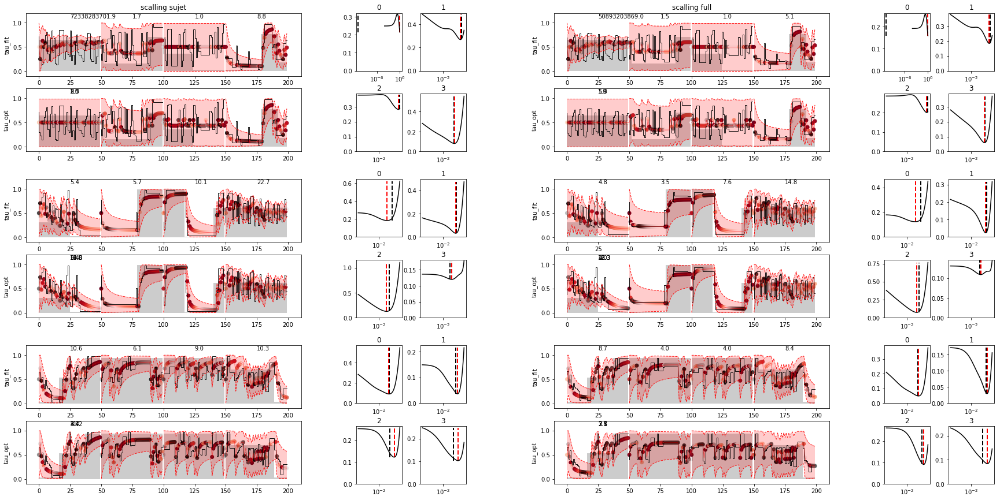

s04

scalling sujet
block 0
pause 0 --> tau_fit=1949.0 , h_fit=0.00051 , tau_opt=1.5 , h_opt=0.68926
pause 1 --> tau_fit=2.0 , h_fit=0.51000 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=2644950884.8 , h_fit=0.00000 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=6.9 , h_fit=0.14529 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=12.4 , h_fit=0.08077 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=1735.1 , h_fit=0.00058 , tau_opt=977.0 , h_opt=0.00102
pause 2 --> tau_fit=4.9 , h_fit=0.20496 , tau_opt=11.2 , h_opt=0.08902
pause 3 --> tau_fit=10.0 , h_fit=0.10039 , tau_opt=5.3 , h_opt=0.18738
block 2
pause 0 --> tau_fit=13.7 , h_fit=0.07324 , tau_opt=26.0 , h_opt=0.03854
pause 1 --> tau_fit=31.9 , h_fit=0.03133 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=21.6 , h_fit=0.04622 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=12.2 , h_fit=0.08178 , tau_opt=17.9 , h_opt=0.05591

scalling full
block 0
pause 0 --> tau_fit=6229667645.8 , h_fit=0.00000 , tau_opt=1.5 , h

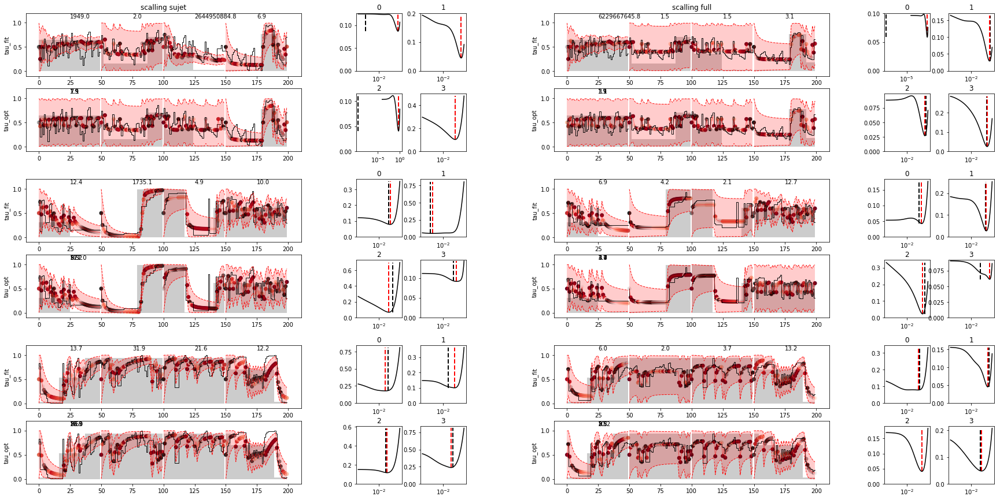

s05

scalling sujet
block 0
pause 0 --> tau_fit=1892547841.2 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=276.7 , h_fit=0.00361 , tau_opt=1.6 , h_opt=0.62803
pause 2 --> tau_fit=2.1 , h_fit=0.48370 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=3.7 , h_fit=0.26670 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=273.0 , h_fit=0.00366 , tau_opt=104.8 , h_opt=0.00955
pause 1 --> tau_fit=14.2 , h_fit=0.07027 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=4.9 , h_fit=0.20214 , tau_opt=9.3 , h_opt=0.10723
pause 3 --> tau_fit=1.7 , h_fit=0.59245 , tau_opt=1.7 , h_opt=0.57224
block 2
pause 0 --> tau_fit=3.3 , h_fit=0.30583 , tau_opt=6.4 , h_opt=0.15557
pause 1 --> tau_fit=4.2 , h_fit=0.23989 , tau_opt=7.1 , h_opt=0.14175
pause 2 --> tau_fit=12.2 , h_fit=0.08210 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=79.1 , h_fit=0.01264 , tau_opt=166.8 , h_opt=0.00599

scalling full
block 0
pause 0 --> tau_fit=7817011540.6 , h_fit=0.00000 , tau_opt=1.0 , h_opt=

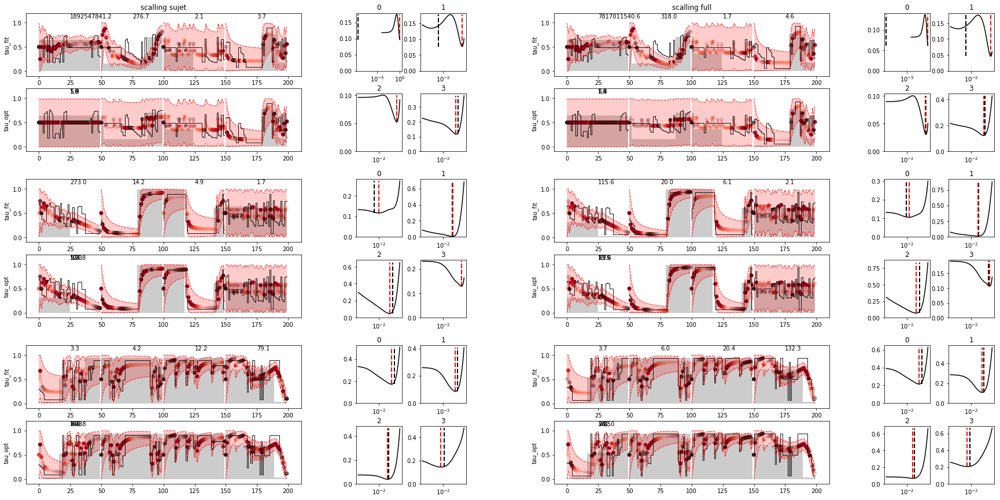

s06

scalling sujet
block 0
pause 0 --> tau_fit=107409650099.8 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=175.1 , h_fit=0.00571 , tau_opt=2.5 , h_opt=0.39442
pause 2 --> tau_fit=45.0 , h_fit=0.02220 , tau_opt=34.3 , h_opt=0.02915
pause 3 --> tau_fit=167.7 , h_fit=0.00596 , tau_opt=17.9 , h_opt=0.05591
block 1
pause 0 --> tau_fit=44.0 , h_fit=0.02272 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=44.1 , h_fit=0.02269 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=46.5 , h_fit=0.02150 , tau_opt=45.3 , h_opt=0.02205
pause 3 --> tau_fit=42.6 , h_fit=0.02347 , tau_opt=34.3 , h_opt=0.02915
block 2
pause 0 --> tau_fit=17.6 , h_fit=0.05695 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=36.9 , h_fit=0.02711 , tau_opt=34.3 , h_opt=0.02915
pause 2 --> tau_fit=470.0 , h_fit=0.00213 , tau_opt=242.0 , h_opt=0.00413
pause 3 --> tau_fit=67.7 , h_fit=0.01476 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=13673228208.5 , h_fit=0.00000 , tau_o

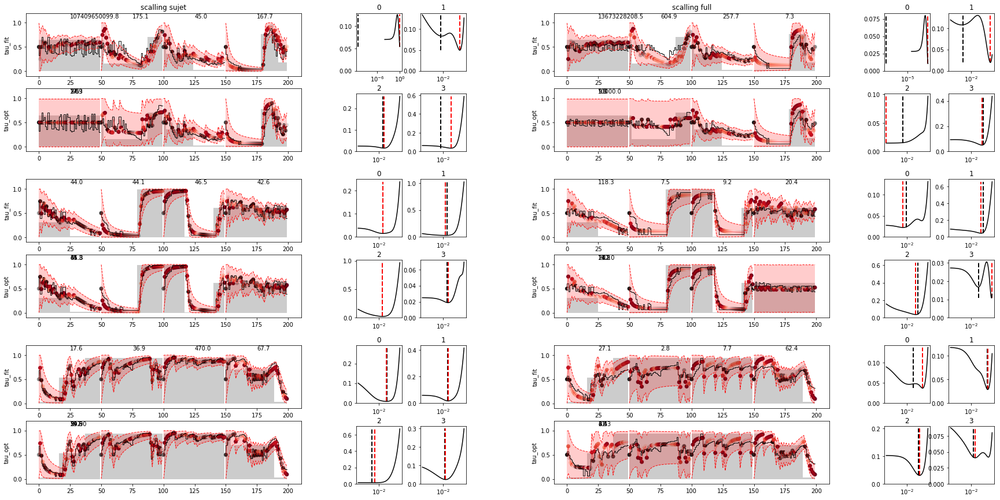

s07

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37489 , tau_opt=2.1 , h_opt=0.47508
pause 1 --> tau_fit=348.1 , h_fit=0.00287 , tau_opt=87.0 , h_opt=0.01150
pause 2 --> tau_fit=39.4 , h_fit=0.02537 , tau_opt=37.6 , h_opt=0.02656
pause 3 --> tau_fit=164.3 , h_fit=0.00609 , tau_opt=79.2 , h_opt=0.01262
block 1
pause 0 --> tau_fit=6.7 , h_fit=0.14900 , tau_opt=4.4 , h_opt=0.22570
pause 1 --> tau_fit=10.0 , h_fit=0.10004 , tau_opt=7.7 , h_opt=0.12915
pause 2 --> tau_fit=16.2 , h_fit=0.06154 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=18.3 , h_fit=0.05456 , tau_opt=1.3 , h_opt=0.75646
block 2
pause 0 --> tau_fit=25.9 , h_fit=0.03861 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=5.2 , h_fit=0.19103 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=22159151579.9 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=88.6 , h_fit=0.01128 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=19.4 , h_fit=0.05151 , tau_opt=1.3 , h_opt=

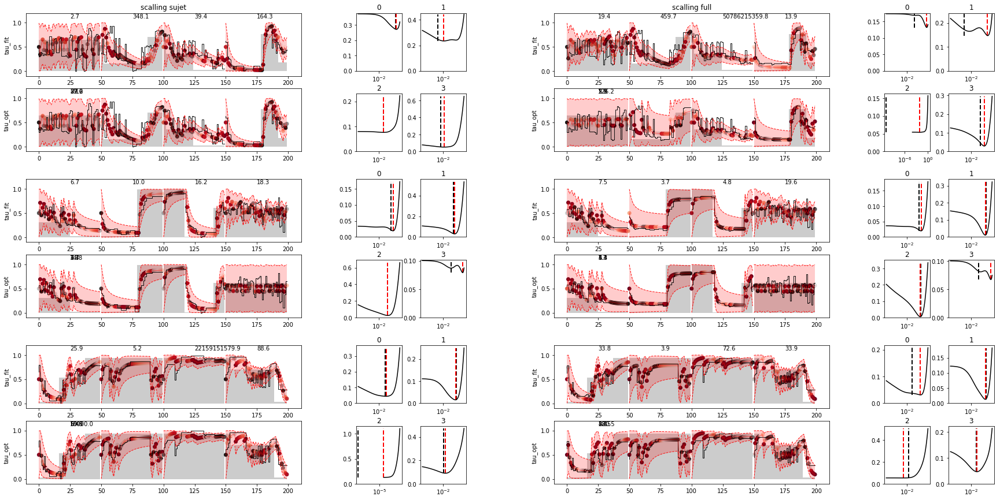

s08

scalling sujet
block 0
pause 0 --> tau_fit=30941237278.3 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=1006.7 , h_fit=0.00099 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=1.3 , h_fit=0.74408 , tau_opt=1.6 , h_opt=0.62803
pause 3 --> tau_fit=6.7 , h_fit=0.14837 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=4.8 , h_fit=0.20688 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=5.6 , h_fit=0.17952 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=6.6 , h_fit=0.15116 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=3624128987.3 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=20.8 , h_fit=0.04808 , tau_opt=12.3 , h_opt=0.08111
pause 1 --> tau_fit=4.9 , h_fit=0.20500 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=5.7 , h_fit=0.17530 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=32.5 , h_fit=0.03077 , tau_opt=23.6 , h_opt=0.04229

scalling full
block 0
pause 0 --> tau_fit=2159676039.8 , h_fit=0.00000 , tau_opt=1.1 

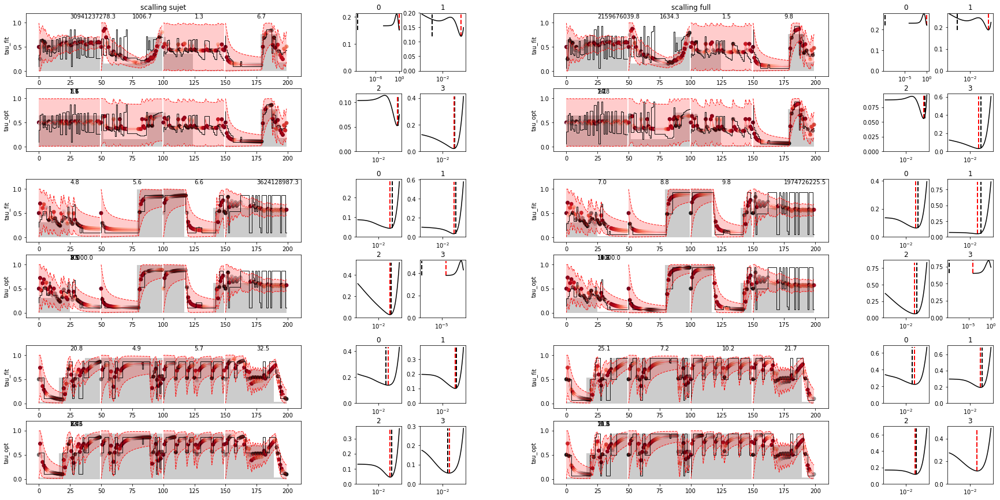

s09

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37241 , tau_opt=3.1 , h_opt=0.32745
pause 1 --> tau_fit=1.6 , h_fit=0.60788 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=5.9 , h_fit=0.17005 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=2.3 , h_fit=0.44250 , tau_opt=2.8 , h_opt=0.35938
block 1
pause 0 --> tau_fit=7.1 , h_fit=0.14115 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=2.1 , h_fit=0.46650 , tau_opt=2.8 , h_opt=0.35938
pause 2 --> tau_fit=3.1 , h_fit=0.32398 , tau_opt=2.8 , h_opt=0.35938
pause 3 --> tau_fit=353.6 , h_fit=0.00283 , tau_opt=1.5 , h_opt=0.68926
block 2
pause 0 --> tau_fit=642.3 , h_fit=0.00156 , tau_opt=1.7 , h_opt=0.57224
pause 1 --> tau_fit=199.9 , h_fit=0.00500 , tau_opt=265.6 , h_opt=0.00376
pause 2 --> tau_fit=3.3 , h_fit=0.29894 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=51.8 , h_fit=0.01932 , tau_opt=115.0 , h_opt=0.00870

scalling full
block 0
pause 0 --> tau_fit=2.4 , h_fit=0.41111 , tau_opt=3.1 , h_opt=0.32745
pause 1 -->

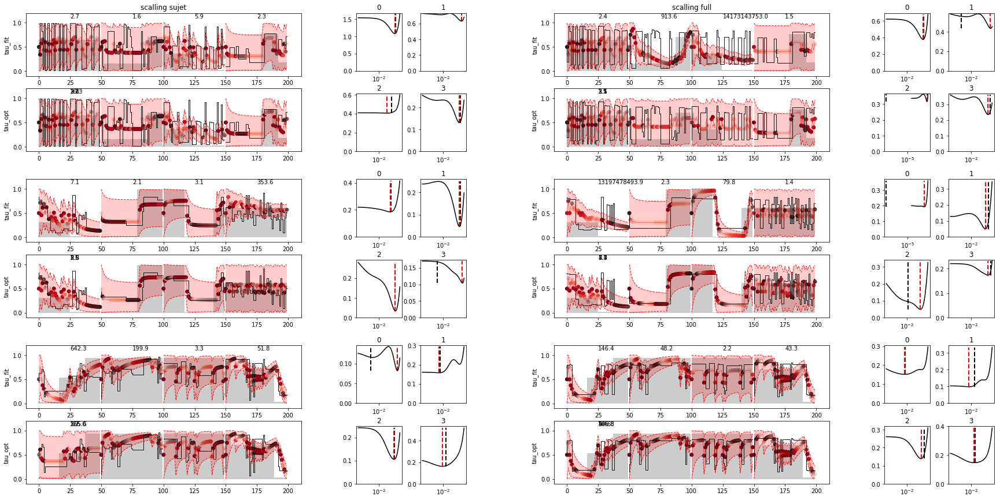

s10

scalling sujet
block 0
pause 0 --> tau_fit=43.6 , h_fit=0.02296 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=4907.5 , h_fit=0.00020 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=21.1 , h_fit=0.04731 , tau_opt=31.3 , h_opt=0.03199
pause 3 --> tau_fit=5.5 , h_fit=0.18323 , tau_opt=10.2 , h_opt=0.09770
block 1
pause 0 --> tau_fit=12.5 , h_fit=0.07985 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=3.7 , h_fit=0.26980 , tau_opt=5.9 , h_opt=0.17074
pause 2 --> tau_fit=3.2 , h_fit=0.31293 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=40.0 , h_fit=0.02498 , tau_opt=49.8 , h_opt=0.02009
block 2
pause 0 --> tau_fit=789.3 , h_fit=0.00127 , tau_opt=1417.5 , h_opt=0.00071
pause 1 --> tau_fit=171.0 , h_fit=0.00585 , tau_opt=385.4 , h_opt=0.00260
pause 2 --> tau_fit=6211635409.6 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=240.0 , h_fit=0.00417 , tau_opt=422.9 , h_opt=0.00236

scalling full
block 0
pause 0 --> tau_fit=65.8 , h_fit=0.01519 , tau_

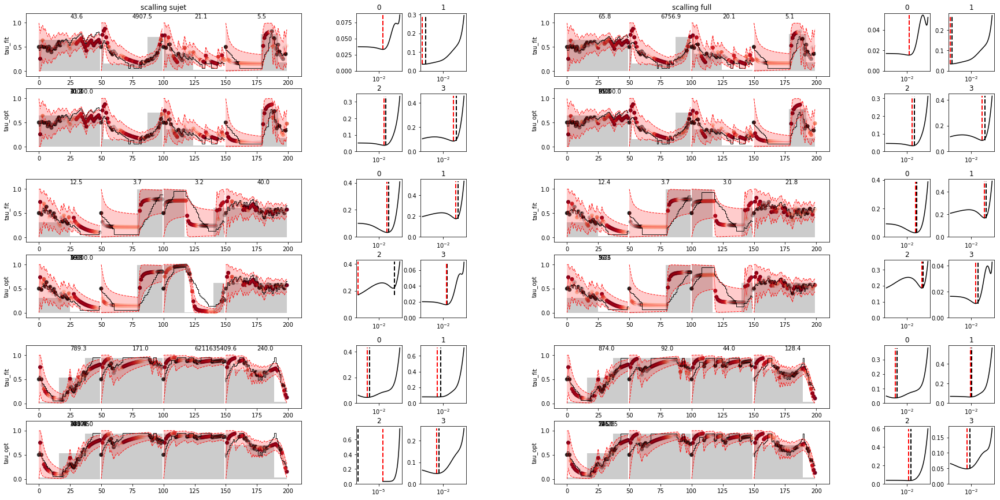

s11

scalling sujet
block 0
pause 0 --> tau_fit=46089042622.6 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=8284.1 , h_fit=0.00012 , tau_opt=1.1 , h_opt=0.91116
pause 2 --> tau_fit=14.3 , h_fit=0.07016 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=13.6 , h_fit=0.07331 , tau_opt=13.5 , h_opt=0.07391
block 1
pause 0 --> tau_fit=23.9 , h_fit=0.04178 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=7.2 , h_fit=0.13819 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=27.1 , h_fit=0.03696 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=16.2 , h_fit=0.06178 , tau_opt=28.5 , h_opt=0.03511
block 2
pause 0 --> tau_fit=191.5 , h_fit=0.00522 , tau_opt=200.9 , h_opt=0.00498
pause 1 --> tau_fit=36.1 , h_fit=0.02769 , tau_opt=19.6 , h_opt=0.05094
pause 2 --> tau_fit=21.2 , h_fit=0.04712 , tau_opt=54.6 , h_opt=0.01831
pause 3 --> tau_fit=24.0 , h_fit=0.04163 , tau_opt=21.5 , h_opt=0.04642

scalling full
block 0
pause 0 --> tau_fit=3282238612.0 , h_fit=0.00000 , tau_op

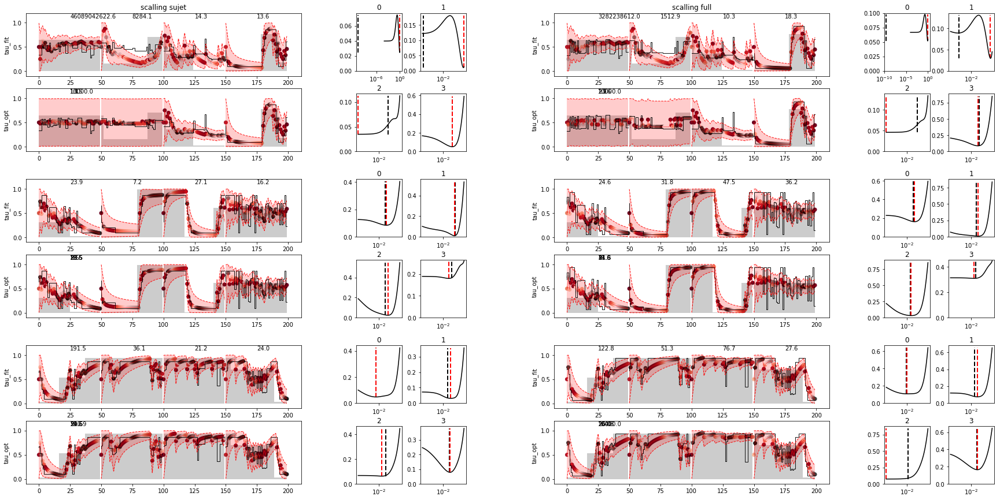

s12

scalling sujet
block 0
pause 0 --> tau_fit=5636195393.2 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=148.7 , h_fit=0.00673 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=413439014.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=2.1 , h_fit=0.48481 , tau_opt=4.0 , h_opt=0.24771
block 1
pause 0 --> tau_fit=17050134249092.5 , h_fit=0.00000 , tau_opt=3274.5 , h_opt=0.00031
pause 1 --> tau_fit=3.0 , h_fit=0.33712 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=3.0 , h_fit=0.32945 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=15.5 , h_fit=0.06444 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=1.9 , h_fit=0.51363 , tau_opt=3.7 , h_opt=0.27186
pause 1 --> tau_fit=2.7 , h_fit=0.36821 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=5.8 , h_fit=0.17375 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=22.7 , h_fit=0.04415 , tau_opt=12.3 , h_opt=0.08111

scalling full
block 0
pause 0 --> tau_fit=169488221763.1 , h_fit=0.00000 

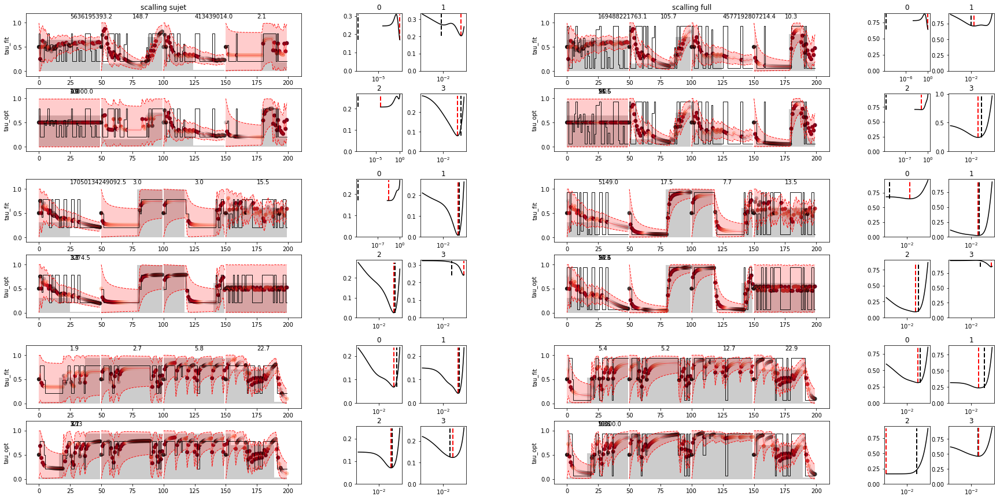

In [15]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full, show='h_pause')

### VA

s01

scalling sujet
block 0

/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:17: RuntimeWarning: All-NaN slice encountered
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: RuntimeWarning: All-NaN slice encountered


 --> tau_fit=2.1 , h_fit=0.46842 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.8 , h_fit=0.20754 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=6172275.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=1.3 , h_fit=0.76028 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.7 , h_fit=0.36605 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=328.9 , h_fit=0.00304 , tau_opt=10000.0 , h_opt=0.00010


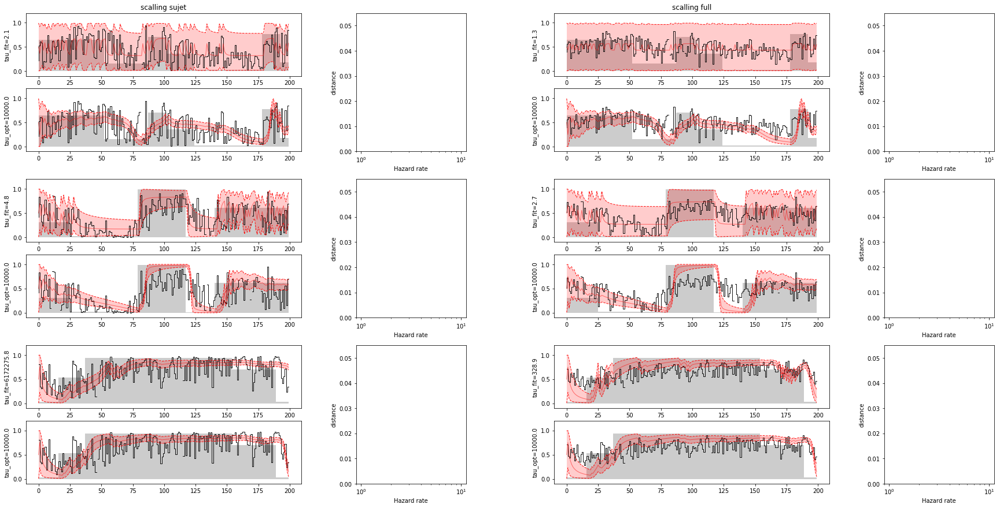

s02

scalling sujet
block 0 --> tau_fit=7.1 , h_fit=0.14151 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.1 , h_fit=0.12370 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=8.1 , h_fit=0.12330 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=3.5 , h_fit=0.28281 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.9 , h_fit=0.20423 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=2.8 , h_fit=0.36351 , tau_opt=10000.0 , h_opt=0.00010


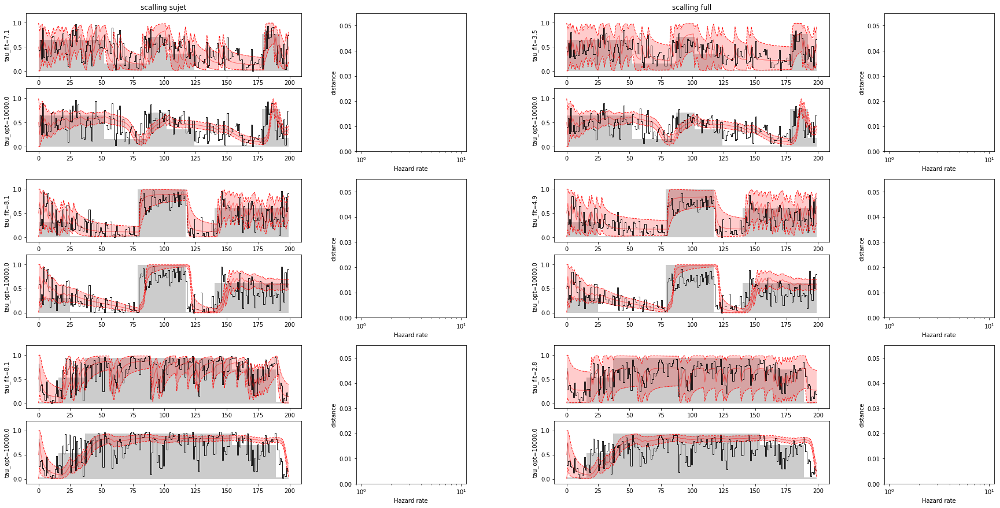

s03

scalling sujet
block 0 --> tau_fit=8.1 , h_fit=0.12383 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.9 , h_fit=0.16951 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=6.9 , h_fit=0.14529 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=4.7 , h_fit=0.21154 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.5 , h_fit=0.28591 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.3 , h_fit=0.30372 , tau_opt=10000.0 , h_opt=0.00010


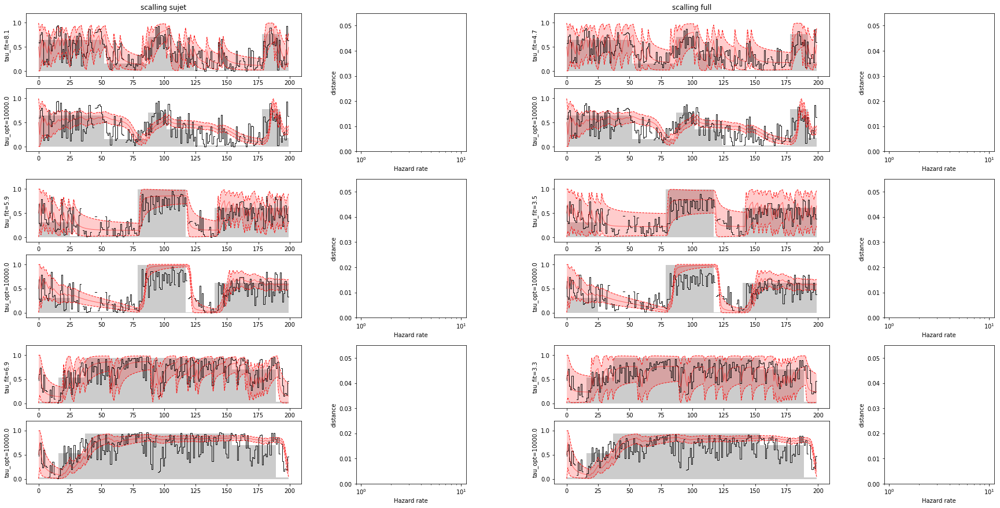

s04

scalling sujet
block 0 --> tau_fit=7.5 , h_fit=0.13383 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.2 , h_fit=0.19110 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=4.4 , h_fit=0.22561 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=5.1 , h_fit=0.19592 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.9 , h_fit=0.25579 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.6 , h_fit=0.27873 , tau_opt=10000.0 , h_opt=0.00010


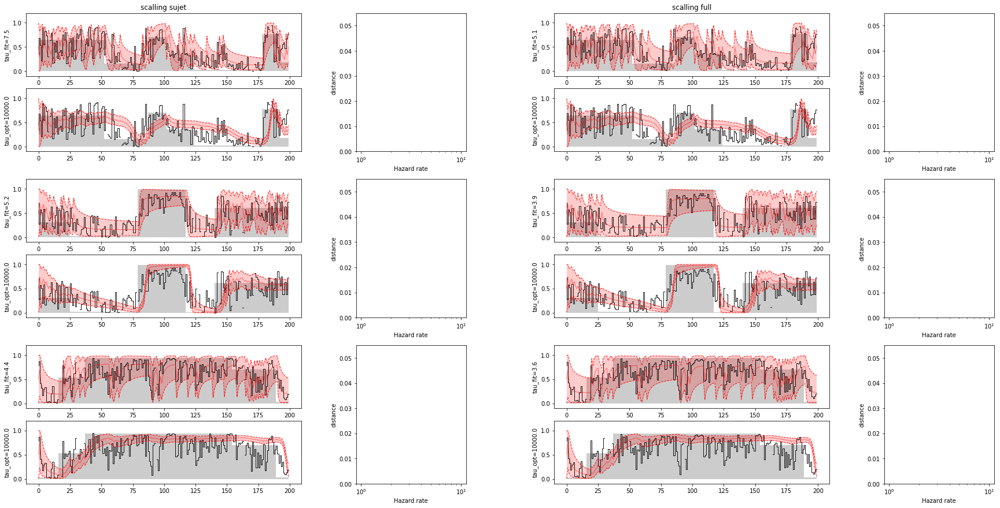

s05

scalling sujet
block 0 --> tau_fit=16.3 , h_fit=0.06124 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.6 , h_fit=0.11594 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.2 , h_fit=0.31013 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=8.3 , h_fit=0.11995 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=9.2 , h_fit=0.10832 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=6.1 , h_fit=0.16416 , tau_opt=10000.0 , h_opt=0.00010


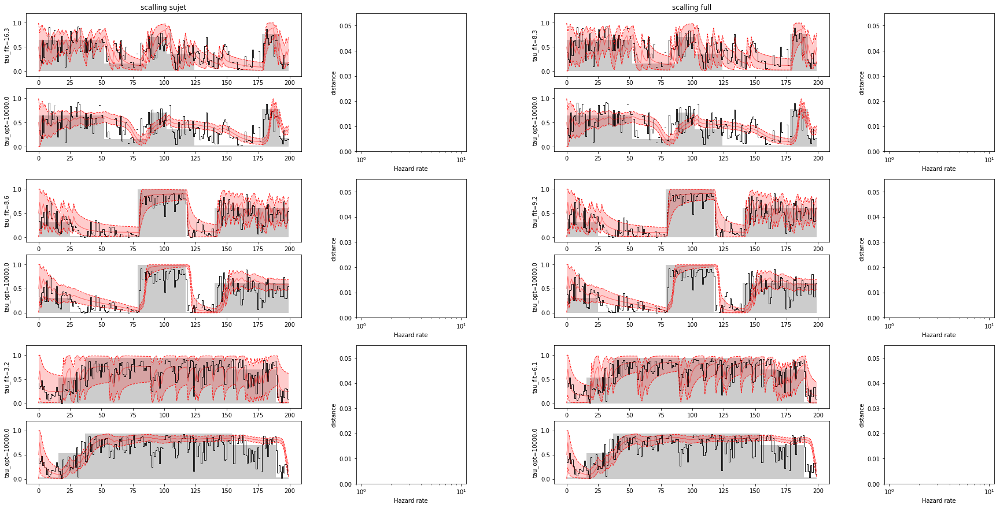

s06

scalling sujet
block 0 --> tau_fit=5.5 , h_fit=0.18244 , tau_opt=7.1 , h_opt=0.14175
block 1 --> tau_fit=6.2 , h_fit=0.16156 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=75.9 , h_fit=0.01317 , tau_opt=31.3 , h_opt=0.03199

scalling full
block 0 --> tau_fit=2.7 , h_fit=0.36411 , tau_opt=4.0 , h_opt=0.24771
block 1 --> tau_fit=3.5 , h_fit=0.28377 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=3.5 , h_fit=0.28335 , tau_opt=4.9 , h_opt=0.20565


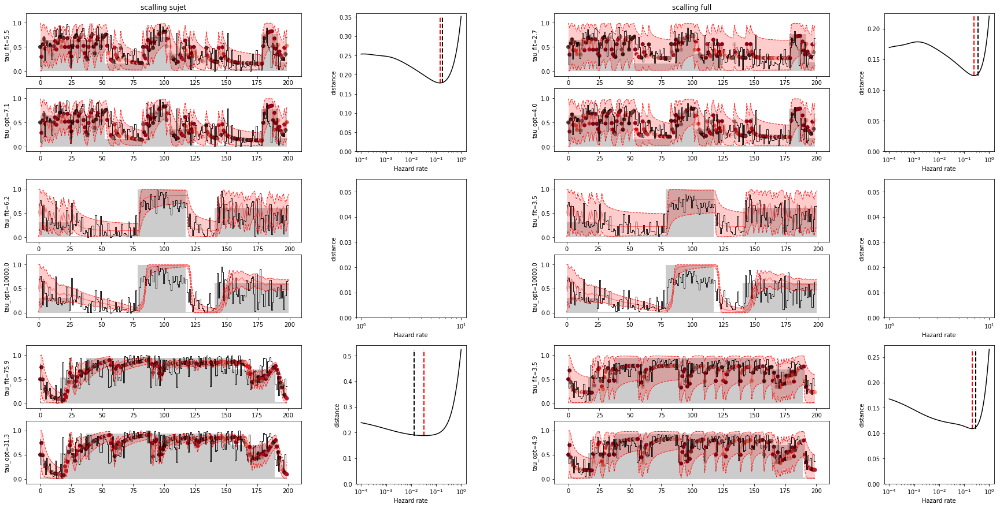

s07

scalling sujet
block 0 --> tau_fit=20.3 , h_fit=0.04929 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.9 , h_fit=0.17049 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=5.0 , h_fit=0.19884 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=20.5 , h_fit=0.04889 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=8.6 , h_fit=0.11589 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=7.7 , h_fit=0.12952 , tau_opt=10000.0 , h_opt=0.00010


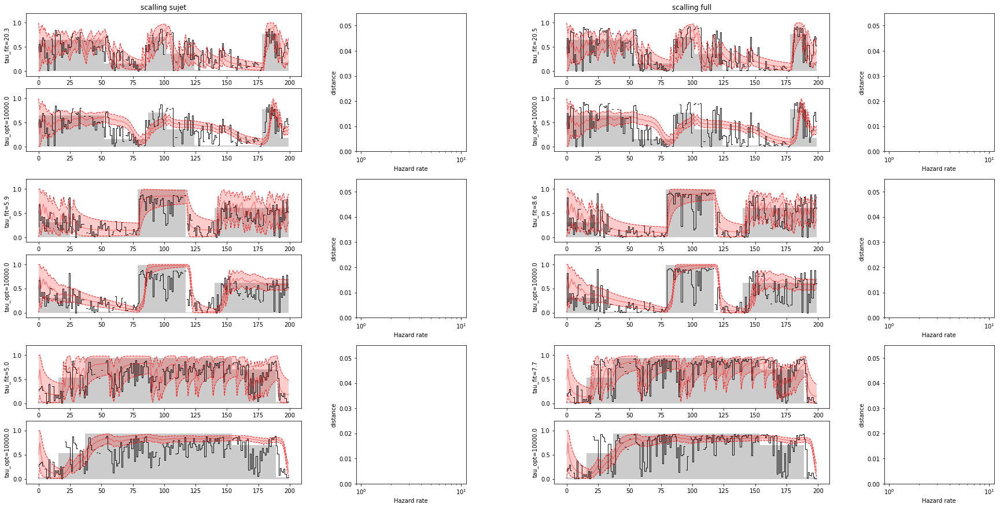

s08

scalling sujet
block 0 --> tau_fit=8.0 , h_fit=0.12490 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.2 , h_fit=0.31701 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=2.4 , h_fit=0.41214 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=4.4 , h_fit=0.22482 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=2.5 , h_fit=0.39587 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1.9 , h_fit=0.53257 , tau_opt=10000.0 , h_opt=0.00010


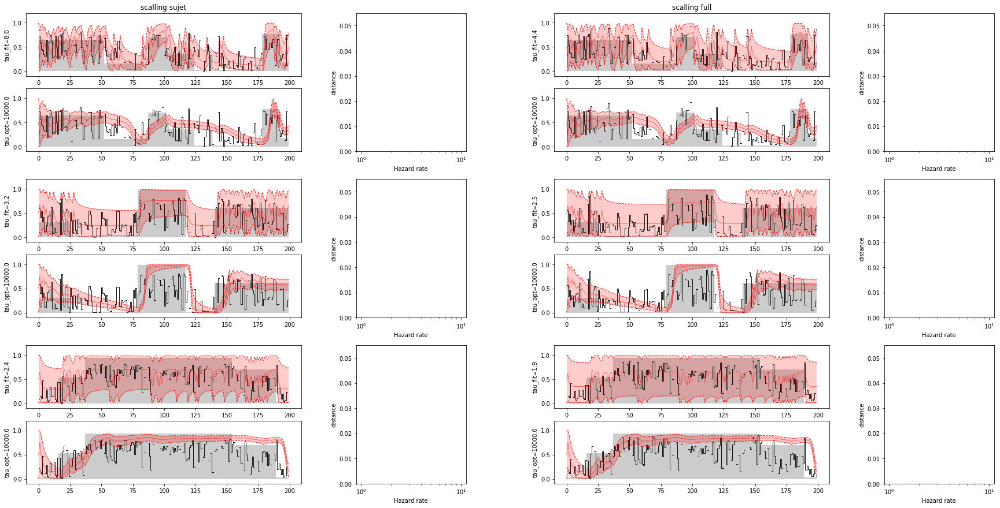

s09

scalling sujet
block 0 --> tau_fit=5.5 , h_fit=0.18262 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.4 , h_fit=0.18359 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=185.4 , h_fit=0.00539 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=6.7 , h_fit=0.14917 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=3.8 , h_fit=0.26647 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1.2 , h_fit=0.80799 , tau_opt=10000.0 , h_opt=0.00010


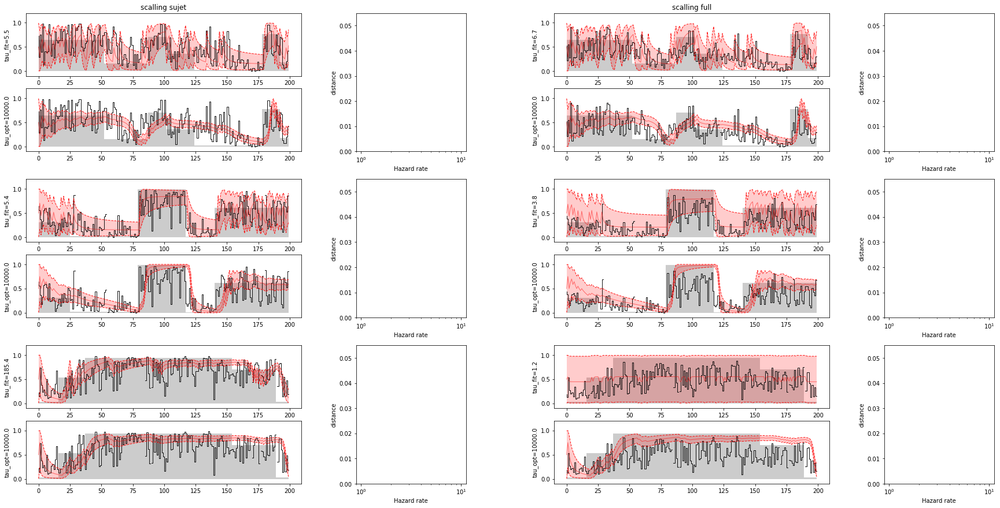

s10

scalling sujet
block 0 --> tau_fit=8.6 , h_fit=0.11643 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=7.8 , h_fit=0.12747 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=8.8 , h_fit=0.11349 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=9.4 , h_fit=0.10671 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=7.9 , h_fit=0.12685 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=6.7 , h_fit=0.14881 , tau_opt=10000.0 , h_opt=0.00010


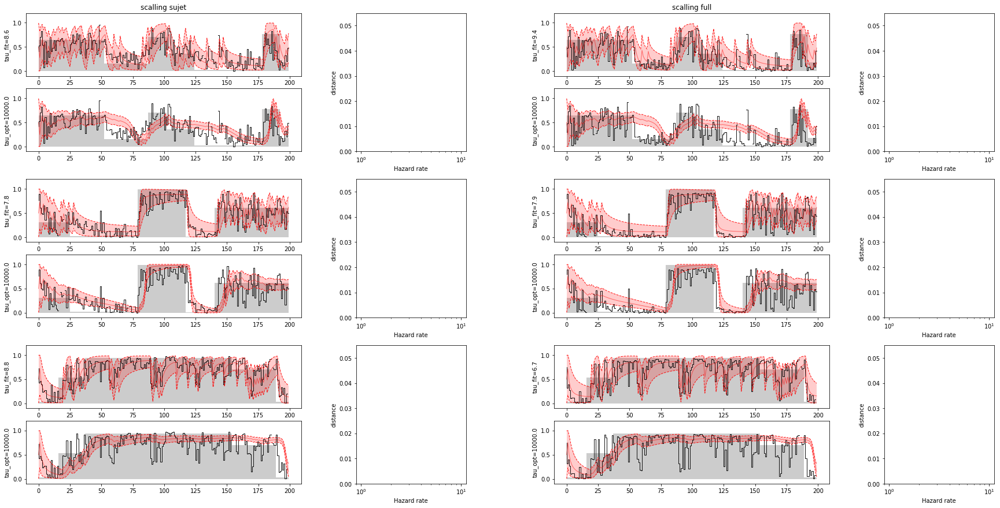

s11

scalling sujet
block 0 --> tau_fit=15.2 , h_fit=0.06582 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=6.6 , h_fit=0.15152 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=4.9 , h_fit=0.20544 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=18.0 , h_fit=0.05569 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=9.5 , h_fit=0.10545 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=4.7 , h_fit=0.21166 , tau_opt=10000.0 , h_opt=0.00010


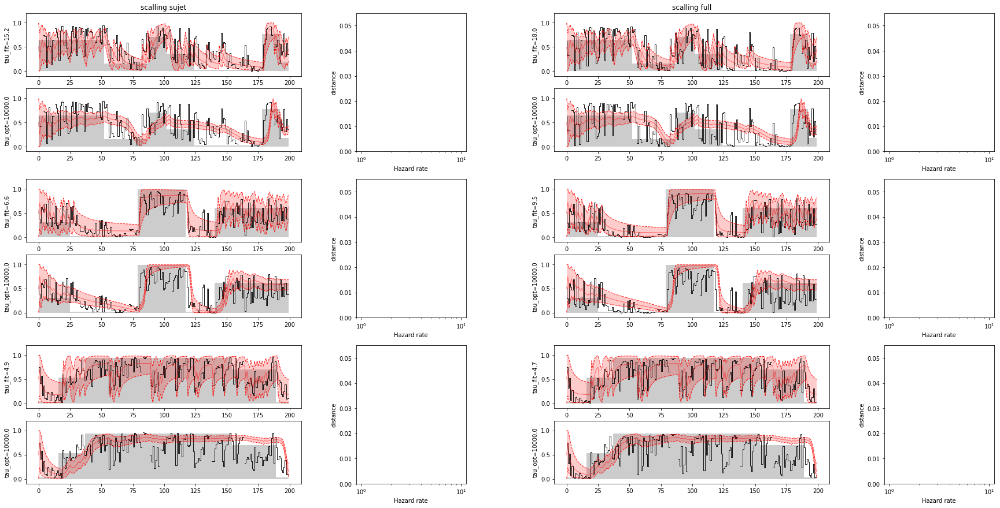

s12

scalling sujet
block 0 --> tau_fit=1.6 , h_fit=0.62649 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.6 , h_fit=0.21831 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1.5 , h_fit=0.66024 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0 --> tau_fit=1.3 , h_fit=0.76271 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.1 , h_fit=0.24635 , tau_opt=10000.0 , h_opt=0.00010
block 2 --> tau_fit=1.9 , h_fit=0.52698 , tau_opt=10000.0 , h_opt=0.00010


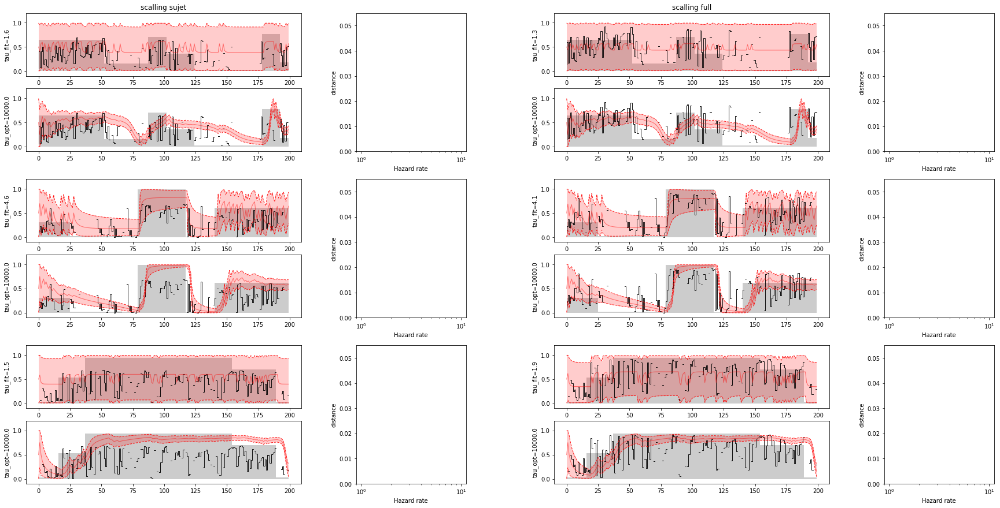

In [16]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full)

s01

scalling sujet
block 0
pause 0

/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:17: RuntimeWarning: All-NaN slice encountered
/home/drone/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: RuntimeWarning: All-NaN slice encountered


 --> tau_fit=12.3 , h_fit=0.08127 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=24603.0 , h_fit=0.00004 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=73.1 , h_fit=0.01369 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=3.7 , h_fit=0.27053 , tau_opt=3.7 , h_opt=0.27186
block 1
pause 0 --> tau_fit=14.2 , h_fit=0.07049 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=6.6 , h_fit=0.15120 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=1.9 , h_fit=0.53966 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.3 , h_fit=0.76897 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=136.4 , h_fit=0.00733 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.4 , h_fit=0.22607 , tau_opt=45.3 , h_opt=0.02205
pause 2 --> tau_fit=22.8 , h_fit=0.04378 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4187.8 , h_fit=0.00024 , tau_opt=2477.1 , h_opt=0.00040

scalling full
block 0
pause 0 --> tau_fit=50.5 , h_fit=0.01978 , tau_opt=10000.0 , h_opt=0.00010
pau

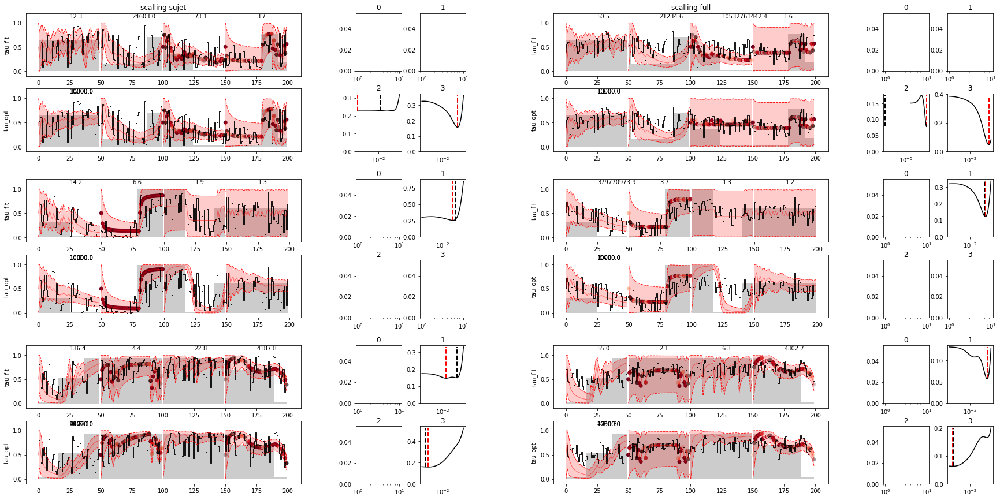

s02

scalling sujet
block 0
pause 0 --> tau_fit=12.8 , h_fit=0.07819 , tau_opt=1.6 , h_opt=0.62803
pause 1 --> tau_fit=202.5 , h_fit=0.00494 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=57424120249.2 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=8.3 , h_fit=0.12062 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=72.3 , h_fit=0.01384 , tau_opt=65.8 , h_opt=0.01520
pause 1 --> tau_fit=9.9 , h_fit=0.10134 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=6.5 , h_fit=0.15463 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.2 , h_fit=0.80400 , tau_opt=1.3 , h_opt=0.75646
block 2
pause 0 --> tau_fit=3.9 , h_fit=0.25412 , tau_opt=5.9 , h_opt=0.17074
pause 1 --> tau_fit=5.3 , h_fit=0.18719 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=7.3 , h_fit=0.13689 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=20.9 , h_fit=0.04790 , tau_opt=19.6 , h_opt=0.05094

scalling full
block 0
pause 0 --> tau_fit=16.9 , h_fit=0.05903 , tau_o

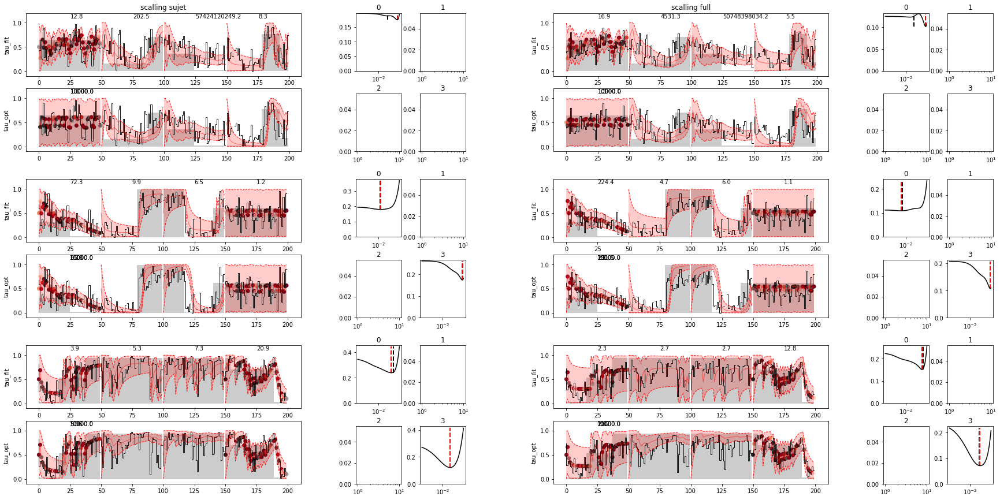

s03

scalling sujet
block 0
pause 0 --> tau_fit=5.0 , h_fit=0.20162 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=5.9 , h_fit=0.17086 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=17.6 , h_fit=0.05696 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.9 , h_fit=0.14467 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=14.1 , h_fit=0.07090 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=5.5 , h_fit=0.18184 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=8.1 , h_fit=0.12271 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.1 , h_fit=0.89025 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=5.1 , h_fit=0.19582 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=5.1 , h_fit=0.19603 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=10.0 , h_fit=0.09974 , tau_opt=8.5 , h_opt=0.11768
pause 3 --> tau_fit=240.8 , h_fit=0.00415 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=14.7 , h_fit=0.06790 , tau_o

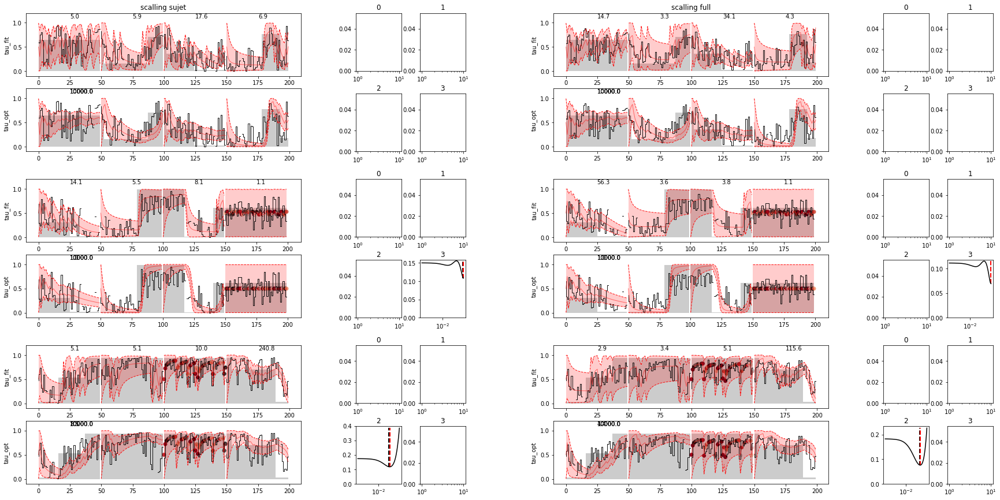

s04

scalling sujet
block 0
pause 0 --> tau_fit=50.5 , h_fit=0.01982 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=6.4 , h_fit=0.15651 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=5.5 , h_fit=0.18041 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=7.6 , h_fit=0.13099 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=197.4 , h_fit=0.00507 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=8.0 , h_fit=0.12436 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=6.2 , h_fit=0.16237 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.2 , h_fit=0.80832 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=7.8 , h_fit=0.12770 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.3 , h_fit=0.42964 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=5.2 , h_fit=0.19346 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=18.1 , h_fit=0.05521 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=74.0 , h_fit=0.01351 , ta

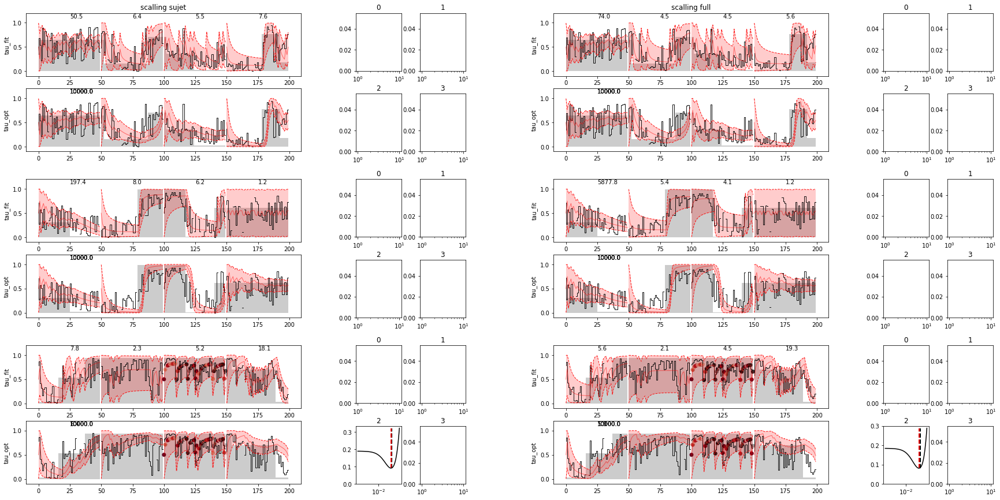

s05

scalling sujet
block 0
pause 0 --> tau_fit=2602696966.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.3 , h_fit=0.42684 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=10.3 , h_fit=0.09703 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.7 , h_fit=0.14953 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=12.2 , h_fit=0.08181 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=15.0 , h_fit=0.06647 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=5.8 , h_fit=0.17143 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=11.1 , h_fit=0.08982 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=8375.9 , h_fit=0.00012 , tau_opt=6280.3 , h_opt=0.00016
pause 1 --> tau_fit=3.8 , h_fit=0.26058 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.6 , h_fit=0.38364 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.5 , h_fit=0.22096 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=1894302007

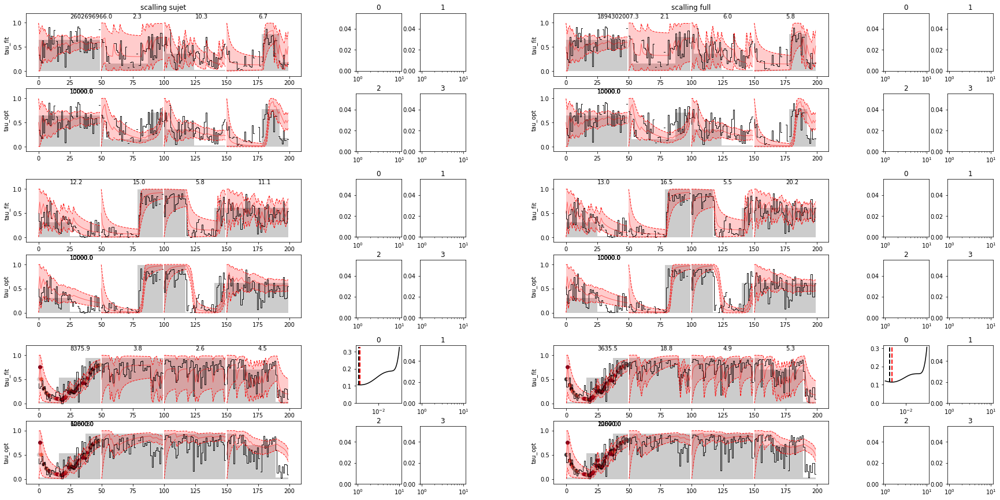

s06

scalling sujet
block 0
pause 0 --> tau_fit=8.1 , h_fit=0.12299 , tau_opt=9.3 , h_opt=0.10723
pause 1 --> tau_fit=3.1 , h_fit=0.32472 , tau_opt=2.8 , h_opt=0.35938
pause 2 --> tau_fit=675.0 , h_fit=0.00148 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.2 , h_fit=0.24028 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=16.3 , h_fit=0.06142 , tau_opt=17.9 , h_opt=0.05591
pause 1 --> tau_fit=9.7 , h_fit=0.10285 , tau_opt=9.3 , h_opt=0.10723
pause 2 --> tau_fit=4.5 , h_fit=0.21990 , tau_opt=4.4 , h_opt=0.22570
pause 3 --> tau_fit=1.0 , h_fit=0.98373 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=4.4 , h_fit=0.22596 , tau_opt=7.7 , h_opt=0.12915
pause 1 --> tau_fit=209.9 , h_fit=0.00476 , tau_opt=59.9 , h_opt=0.01668
pause 2 --> tau_fit=43.3 , h_fit=0.02308 , tau_opt=49.8 , h_opt=0.02009
pause 3 --> tau_fit=166.0 , h_fit=0.00602 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0
pause 0 --> tau_fit=11.9 , h_fit=0.08411 , tau_opt=11.2 , h_opt=0.08902
pa

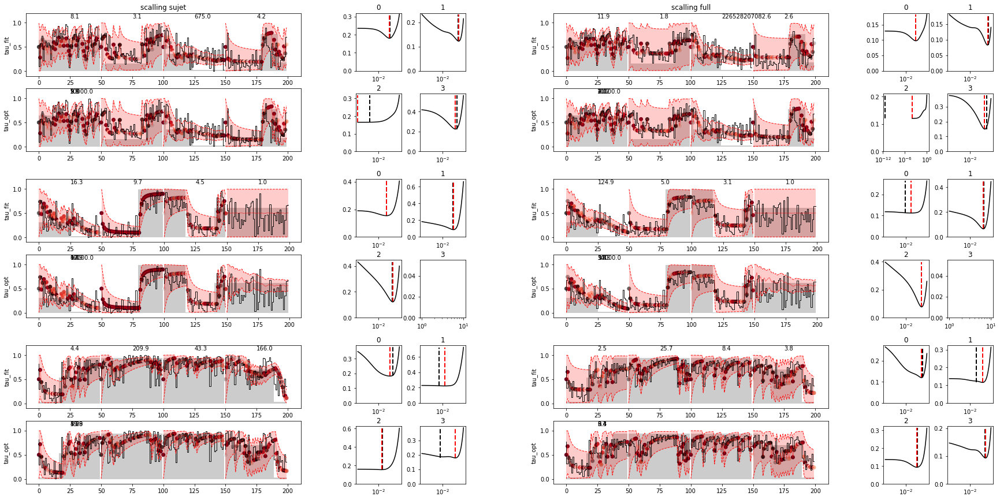

s07

scalling sujet
block 0
pause 0 --> tau_fit=1277.8 , h_fit=0.00078 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=13.6 , h_fit=0.07332 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=19.9 , h_fit=0.05036 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.7 , h_fit=0.14970 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=10.7 , h_fit=0.09368 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=4.5 , h_fit=0.22460 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=6.8 , h_fit=0.14689 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=16.6 , h_fit=0.06037 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=2.0 , h_fit=0.50886 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.9 , h_fit=0.34723 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=8.9 , h_fit=0.11200 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=43.3 , h_fit=0.023

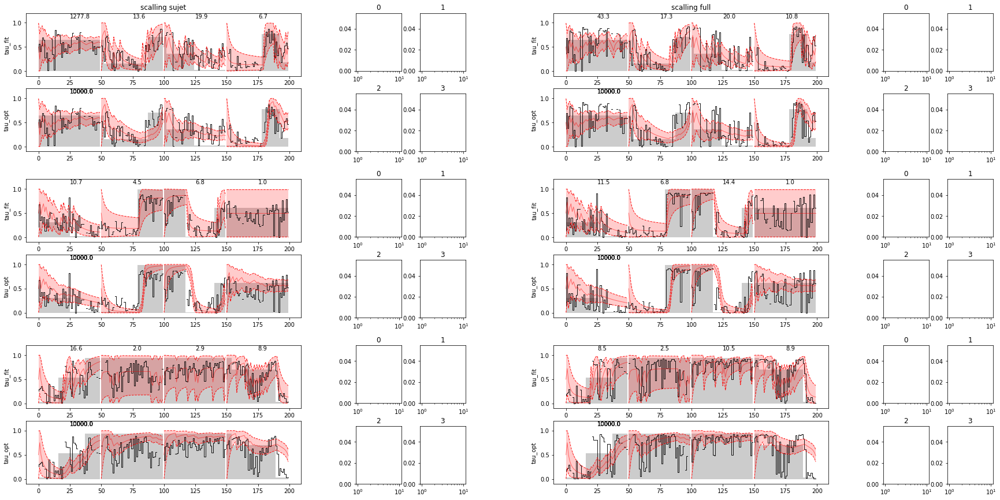

s08

scalling sujet
block 0
pause 0 --> tau_fit=12744390219.1 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=60.4 , h_fit=0.01654 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=15.3 , h_fit=0.06520 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.6 , h_fit=0.21542 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=27.1 , h_fit=0.03691 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=3.3 , h_fit=0.30226 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=2.3 , h_fit=0.44082 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.1 , h_fit=0.94999 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=71460.5 , h_fit=0.00001 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=1.4 , h_fit=0.72349 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=1.4 , h_fit=0.72400 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=2.0 , h_fit=0.50626 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=18871511

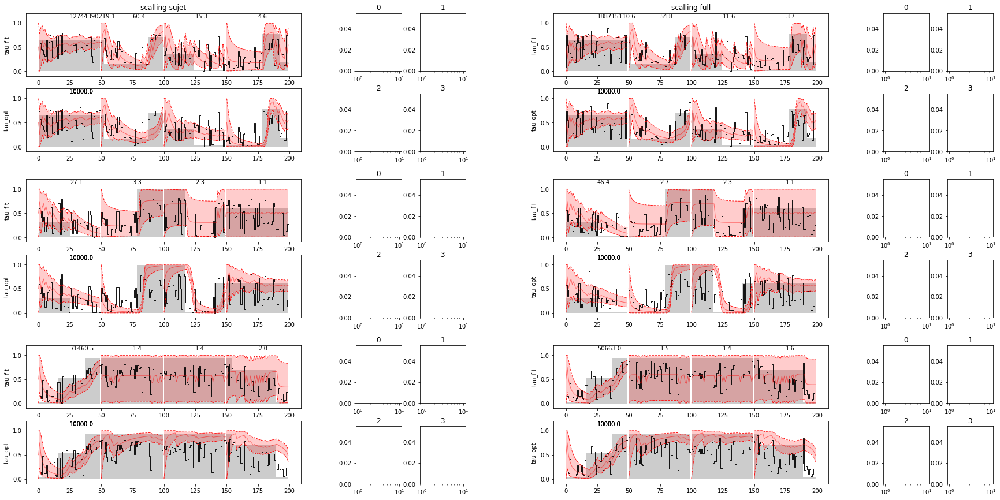

s09

scalling sujet
block 0
pause 0 --> tau_fit=26.0 , h_fit=0.03839 , tau_opt=21.5 , h_opt=0.04642
pause 1 --> tau_fit=633.9 , h_fit=0.00158 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=46388449680.7 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=8.3 , h_fit=0.12013 , tau_opt=10.2 , h_opt=0.09770
block 1
pause 0 --> tau_fit=8.6 , h_fit=0.11604 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=5.8 , h_fit=0.17378 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=3.9 , h_fit=0.25504 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=145.0 , h_fit=0.00689 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=416.9 , h_fit=0.00240 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=93.1 , h_fit=0.01074 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=3.8 , h_fit=0.25974 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=138.9 , h_fit=0.00720 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=1095.6 , h_fit=0.00091 

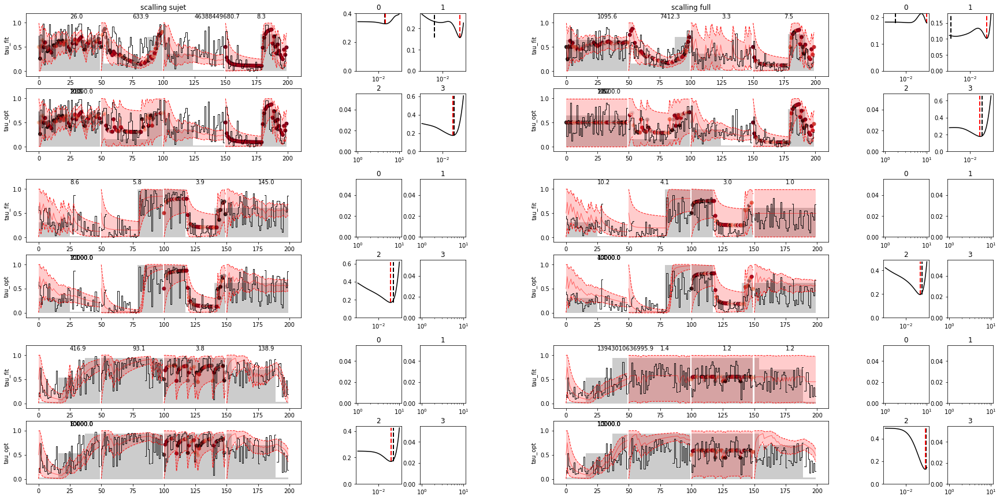

s10

scalling sujet
block 0
pause 0 --> tau_fit=193.5 , h_fit=0.00517 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=7.7 , h_fit=0.12946 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=19.8 , h_fit=0.05052 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=5.9 , h_fit=0.16996 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=8.7 , h_fit=0.11527 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=10.6 , h_fit=0.09423 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=11.4 , h_fit=0.08742 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=3.8 , h_fit=0.26105 , tau_opt=3.7 , h_opt=0.27186
block 2
pause 0 --> tau_fit=14.4 , h_fit=0.06924 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=10.3 , h_fit=0.09706 , tau_opt=7.1 , h_opt=0.14175
pause 2 --> tau_fit=10.7 , h_fit=0.09313 , tau_opt=10.2 , h_opt=0.09770
pause 3 --> tau_fit=8.9 , h_fit=0.11256 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=98.9 , h_fit=0.01011 , tau_opt=10000.0

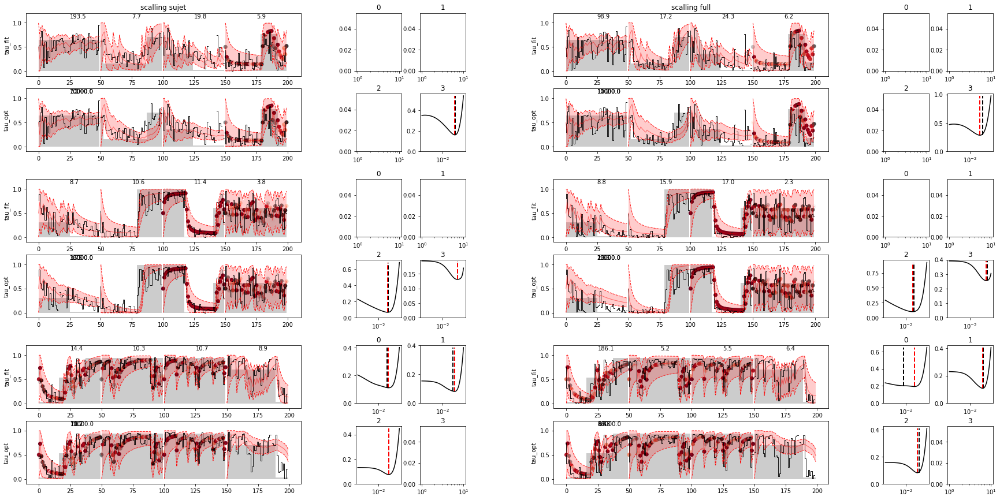

s11

scalling sujet
block 0
pause 0 --> tau_fit=59.5 , h_fit=0.01682 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=36.6 , h_fit=0.02732 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=30584371471.7 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=11.4 , h_fit=0.08800 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=7.7 , h_fit=0.12956 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=10.9 , h_fit=0.09194 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=7.5 , h_fit=0.13421 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=21.1 , h_fit=0.04739 , tau_opt=87.0 , h_opt=0.01150
pause 1 --> tau_fit=5.2 , h_fit=0.19250 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=4.1 , h_fit=0.24187 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=4.2 , h_fit=0.24083 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_fit=41.8 , h_fit=0.02

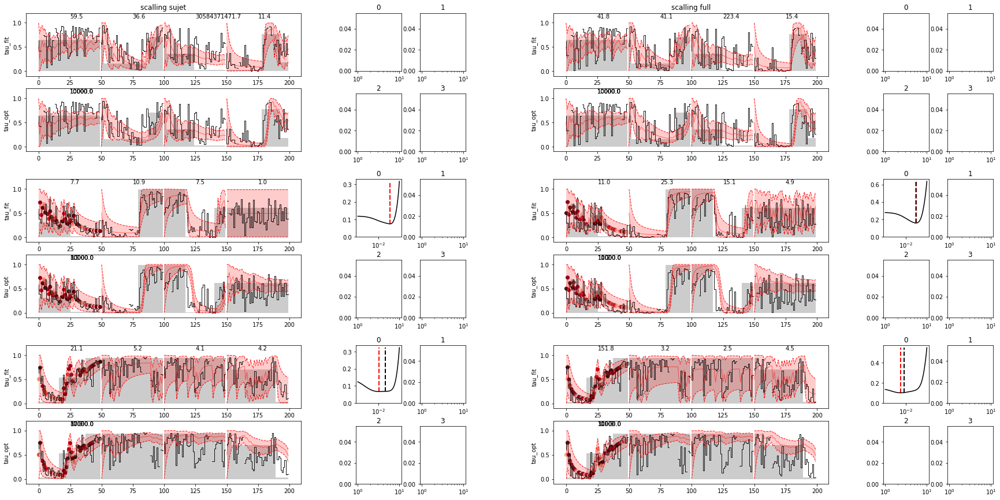

s12

scalling sujet
block 0
pause 0 --> tau_fit=24362553671.3 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=148306.0 , h_fit=0.00001 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=4.4 , h_fit=0.22640 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=3.1 , h_fit=0.32443 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=5.4 , h_fit=0.18374 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=7.6 , h_fit=0.13082 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=4.6 , h_fit=0.21659 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=75217285591246.2 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 1 --> tau_fit=1.6 , h_fit=0.62154 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=1.9 , h_fit=0.52311 , tau_opt=10000.0 , h_opt=0.00010

scalling full
block 0
pause 0 --> tau_f

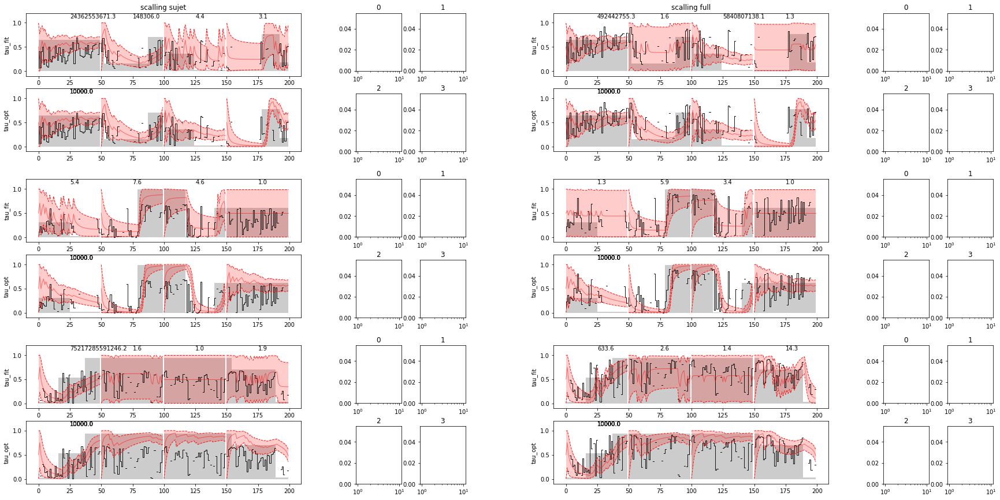

In [17]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full, show='h_pause')